# <div style="text-align: center"> ------------------------Projet 9-----------------------  </div>
#  <div style="text-align: center">-----------Produire une Etude de Marché-----------</div>
# <div style="text-align: center">-Préparation, Nettoyage et Analyse des données-  </div>

![logo](logo.png)

Auteur: Lauren GUIOT

Date: 07/04/2023

## introduction
<br>
<div style="text-align: justify">Notre entreprise, spécialisée dans l’agroalimentaire, envisage d’étendre l’exportation de sa production de poulet à l’international. 
Le choix de pays étant vaste, Patrick m’a demandé d’analyser et sélectionner des groupes de pays ayant le plus fort potentiel de développement. <br>
    <br>
Le service pourra alors cibler et approfondir l’étude de marché sur les pays sélectionnés.  </div>

#### <div style="text-align: justify"> Ce book présentera la sélection et le nettoyage des données qui nous servirons à l'étude des différents Clusters. Nous analyserons également les Variables ansi que les Pays grâce à la méthode de l'Analyse Composante Principale afin de mieux  les comprendre pour notre clustering. </div>


# Sommaire <a class="anchor" id="sommaire"></a>

* [I. Importation](#I)

* [II. Découverte des données](#II)
    * [Consommation](#II.1)
    * [Economique](#II.a.2)
    * [Socio Culturel et Politique](#II.a.3)
    * [Ecologique](#II.a.4)

* [III. Nettoyage](#III)
    * [a. Création de valeurs](#III.a)
    * [b. Nettoyage et Formatage](#III.b)
    * [c. Jointure](#III.c)
    * [d. Préparation](#III.d)

* [IV. Analyse](#IV)
    * [a. Univarié](#IV.a)
    * [b. Bivarié](#IV.b) 
    * [c. Exploratoire](#IV.c)
        * [eboulis](#IV.c.1)
        * [Lien entre variables](#IV.c.2)
        * [Lien entre Individus](#IV.c.3)

# I.Importation  <a class="anchor" id="I"></a>

In [1]:
# Importation des différentes Librairies

import numpy as np                                           # v1.19.2
import pandas as pd                                          # v1.2.5

                                                             # sklearn v0.23.2
from sklearn.preprocessing import StandardScaler             # Centré-Réduire
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import minmax_scale
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import QuantileTransformer
from sklearn.preprocessing import PowerTransformer                  
from sklearn.ensemble import IsolationForest                  # Détecter Outliers
from sklearn import decomposition                             # ACP

import seaborn as sns  ; sns.set()                           # v 0.11.0 
import matplotlib.pyplot as plt                              # v 3.3.2

# Module a installer
from yellowbrick.cluster import KElbowVisualizer             # v 1.4 Methode coude
from yellowbrick.cluster import SilhouetteVisualizer

import dataprep
from dataprep.eda import create_report


In [2]:
# Customiser la présentation des polices
class P:
    H = '\033[95m'  #Header
    BL = '\033[94m'  # Bleu
    G = '\033[92m' # Vert
    R = '\033[93m' #Rouge
    E = '\033[0m' # End
    B = '\033[1m' #Bold
    U = '\033[4m' # Underline

# Visualiser les valeurs uniques de chaque variable        
def valunique(table) :
    for i in table : 
        unique= table[i].unique()
        if len(unique) < 50 :
            print(P.U + i +P.E,len(unique),"valeurs différentes""\n", unique, "\n" )
        else :
            print(P.U + i +P.E,len(unique),"valeurs différentes" "\n" )
            
# exploration des données (doublon NaN, uniques, structure, etc.)            
def exploration(table):
    table.describe(include='all')
    vnames = [name for name in globals() if globals()[name] is table]
    print(P.H +P.U + (f'ANALYSE STRUCTURE de la table {vnames}')+ P.E)
    print(P.B + P.G+f" Taille:{table.shape}"+P.E)
    print('\n', P.B+ P.G+ 'Types de variable: '+ P.E)
    print(table.info())
    print(P.B+ P.G+ '\nDonnées Uniques: ' +P.E)
    print(valunique(table))
    print(P.B+ P.G+ '\nAnalyse Doublons: ' +P.E)
    print(table.duplicated().sum())
    print(P.B + P.G+ '\nDonnées Manquantes: ' +P.E)
    print(table.isna().mean())
    print(sns.heatmap(table==0.0, cbar=False))
    print(P.B+ P.G+ '\nAnalyse Globales & Heat map des valeurs manquantes: ' +P.E)
    
# exploration descriptive des tables
def explo(table):
    return table.describe(include='all')

# Cercle de corrélation
def correlation_graph(pca, x_y, features) :   
    x,y=x_y

    fig, ax = plt.subplots(figsize=(8, 8))

    #Création du graphique
    for i in range(0, pcs.shape[1]):
        ax.arrow(0,0, pcs[x, i], pcs[y, i],head_width=0.03,
                head_length=0.03, color='red', width=0.01, )

        plt.text(pcs[x,i]+0.02, pcs[y,i]+0, features[i], fontsize=14)
        
    plt.plot([-1, 1], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 1], color='grey', ls='--')

    # Nom des axes, avec le pourcentage d'inertie expliqué
    plt.xlabel('F{} ({}%)'.format(x+1, round(scree[x],1)))
    plt.ylabel('F{} ({}%)'.format(y+1, round(scree[y],1)))
    
    plt.title("Cercle des corrélations (F{} et F{}) à {}%".format(x+1, y+1, (round(scree[x]+scree[y], 2))))
    
    # Le cercle 
    plt.gca().add_artist(plt.Circle((0,0), 1, facecolor='none', edgecolor='purple'))


    # Axes et display
    plt.axis('equal')
    plt.show(block=False)
    
# Projection des individus
def display_factorial_planes( PCA, label1, label2, x, y, echel1, echel2,clusters=None, centroid= None, figsize=(15,15) ):

    ces = (15,15) if figsize is None else figsize    
    fig, ax = plt.subplots(1,1, figsize=ces)

    c = None if clusters is None else clusters
    ce= None if centroid is None else plt.scatter(centroids_projected[:,x],centroids_projected[:,y], s=200, 
                                                  marker= 's', c='green', alpha=0.3, label='centroids', cmap= 'jet') 

    
    #Nuage de Points
    sns.scatterplot(data=None, x=PCA[label1], y=PCA[label2], hue=c, palette="deep", style=c)
    
    
    # Affichage des pays
    for k in PCA.iterrows():
        if (abs(k[1][label1]) > echel1) | (abs(k[1][label2]) > echel2):
            ax.annotate(k[1]["Country"], (k[1][label1], k[1][label2]), fontsize = 15)

    # Variance
    v1 = str(round(scree[x]))  + " %"
    v2 = str(round(scree[y]))  + " %"
    ax.set_xlabel(f'F{x+1} {v1}')
    ax.set_ylabel(f'F{y+1} {v2}')
    
    # Bornage            ====================> Même echelle 
    x_max = abs(PCA[label1].max()) *1.1
    y_max = abs(PCA[label2].max()) *1.1
    ax.set_xlim(left=-x_max, right=x_max)
    ax.set_ylim(bottom= -y_max, top=y_max)
    plt.plot([-x_max, x_max], [0,0], color='silver', ls='--', linewidth=1)
    plt.plot( [0,0], [-y_max, y_max], color='grey', ls='--', linewidth=1)
    plt.title(f"Projection des {PCA.shape[0]} individus sur le {x+1}e et {y+1}eme plan factoriel")
    plt.grid(color='white')
    plt.show()    
    

In [3]:
# Consommation
dispo2=pd.read_csv('DisponibiliteAlimentaire_2019.csv') 
disp=pd.read_csv('DisponibiliteAlimentaire_2020.csv')

#Economique
PouvoirAchat= pd.read_csv('PrixConso.csv')
PrixProduction= pd.read_csv('PrixProduction.csv')
indiceCom= pd.read_csv('IndiceCom.csv')
PIB=pd.read_csv("PIB.csv")

#Socio Culturel et Politique
popu=pd.read_csv('Population_2012_2020.csv')
SecuAlim=pd.read_csv('Secu_alim.csv')

#Ecologique
Pays= pd.read_csv("Pays.csv")
distance= pd.read_csv('distance.csv')

pd.set_option('display.max_columns', None)

Importation des différentes tables nécessaire à mon analyse.
La majorité des données proviennent du site Internet FAOSTAT. <br>
- disponibilité alimentaire = "https://www.fao.org/faostat/fr/#data/FBS" 
- Pouvoi d'achat = "https://www.fao.org/faostat/fr/#data/CP"
- Prix à la production =" https://www.fao.org/faostat/fr/#data/PP"
- Indices Commerciaux =" https://www.fao.org/faostat/fr/#data/TI"
- PIB = "https://www.fao.org/faostat/fr/#data/MK"
- Population et Pays = "https://www.fao.org/faostat/fr/#data/OA"
- Sécurité Alimentaire =" https://www.fao.org/faostat/fr/#data/FS"
- Distance = "http://www.cepii.fr/CEPII/en/bdd_modele/bdd_modele_item.asp?id=6"

* [sommaire](#sommaire)

# II. Découverte des données <a class="anchor" id="II"></a>

<a class="anchor" id="II.1"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Consommation</h2>




In [4]:
disp.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit (CPC),Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole
0,FBS,Bilans Alimentaires (2010-),2,Afghanistan,5511,Production,S2511,Blé et produits,2020,2020,Milliers de tonnes,5185.0,I,Valeur imputée


ANALYSE STRUCTURE de la table ['disp']
 Taille:(87704, 14)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87704 entries, 0 to 87703
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Code Domaine            87704 non-null  object 
 1   Domaine                 87704 non-null  object 
 2   Code zone (FAO)         87704 non-null  int64  
 3   Zone                    87704 non-null  object 
 4   Code Élément            87704 non-null  int64  
 5   Élément                 87704 non-null  object 
 6   Code Produit (CPC)      87704 non-null  object 
 7   Produit                 87704 non-null  object 
 8   Code année              87704 non-null  int64  
 9   Année                   87704 non-null  int64  
 10  Unité                   87704 non-null  object 
 11  Valeur                  87704 non-null  float64
 12  Symbole                 87704 non-null  object 
 13  Descriptio

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit (CPC),Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole
count,87704,87704,87704.000000,87704,87704.000000,87704,87704,87704,87704.0,87704.0,87704,87704.000000,87704,87704
unique,1,1,NaN,186,NaN,6,98,98,NaN,NaN,3,NaN,2,2
top,FBS,Bilans Alimentaires (2010-),NaN,Chine,NaN,Importations - Quantité,S2605,"Légumes, autres",NaN,NaN,Milliers de tonnes,NaN,I,Valeur imputée
freq,87704,87704,NaN,560,NaN,16565,1109,1109,NaN,NaN,55964,NaN,48699,48699
mean,NaN,NaN,129.264800,NaN,3768.456923,NaN,NaN,NaN,2020.0,2020.0,NaN,281.822560,NaN,NaN
std,NaN,NaN,75.713545,NaN,2344.851714,NaN,NaN,NaN,0.0,0.0,NaN,5748.733808,NaN,NaN
min,NaN,NaN,1.000000,NaN,664.000000,NaN,NaN,NaN,2020.0,2020.0,NaN,0.000000,NaN,NaN
25%,NaN,NaN,66.000000,NaN,674.000000,NaN,NaN,NaN,2020.0,2020.0,NaN,0.000000,NaN,NaN
50%,NaN,NaN,124.000000,NaN,5142.000000,NaN,NaN,NaN,2020.0,2020.0,NaN,1.000000,NaN,NaN
75%,NaN,NaN,193.000000,NaN,5611.000000,NaN,NaN,NaN,2020.0,2020.0,NaN,18.000000,NaN,NaN


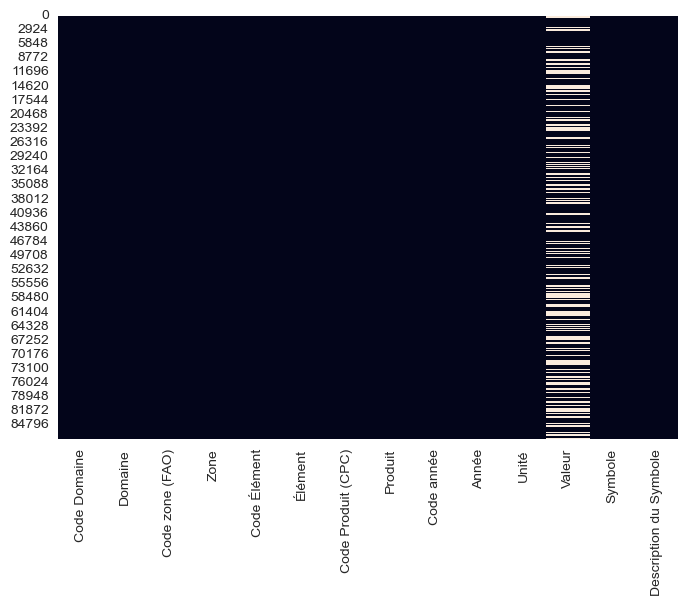

In [5]:
exploration(disp)
explo(disp)

<div style="text-align: justify"> La table disponibilité alimentaire nous fournis les informations nécessaires concernant la consommation de volaille dans les différents pays du monde.
<br>
On y retrouve les données relatives à la production de poulet, à l'importation et l'exportation de poulet, la consommation de poulet et enfin la disponibilité alimentaire de volaille et de protéine de 186 pays différents. 
<br>
On y retrouve aucune donnée Manquante ni doublon. Par contre, il y a un certain nombre de valeur à 0.0 dans la variable "Valeur".
<br>
J'ai repris des données plus récentes à 2020 afin d'avoir des informations plus d'actualité. </div>

* [sommaire](#sommaire)

<a class="anchor" id="II.a.2"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Economique</h2>


In [6]:
PouvoirAchat.head(2)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code année,Année,Code Produit,Produit,Code Mois,Mois,Unité,Valeur,Symbole,Description du Symbole,Note
0,CP,Indices de Prix à la Consommation,2,Afghanistan,2001,2001,23014,Food price inflation,7001,Janvier,%,22.943765,Fc,Donnée calculée,NaN
1,CP,Indices de Prix à la Consommation,2,Afghanistan,2002,2002,23014,Food price inflation,7001,Janvier,%,11.612646,Fc,Donnée calculée,NaN


ANALYSE STRUCTURE de la table ['PouvoirAchat']
 Taille:(156408, 15)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 156408 entries, 0 to 156407
Data columns (total 15 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   Code Domaine            156408 non-null  object 
 1   Domaine                 156408 non-null  object 
 2   Code zone (FAO)         156408 non-null  int64  
 3   Zone                    156408 non-null  object 
 4   Code année              156408 non-null  int64  
 5   Année                   156408 non-null  int64  
 6   Code Produit            156408 non-null  int64  
 7   Produit                 156408 non-null  object 
 8   Code Mois               156408 non-null  int64  
 9   Mois                    156408 non-null  object 
 10  Unité                   50208 non-null   object 
 11  Valeur                  156408 non-null  float64
 12  Symbole                 146239 non-nul

,Code Domaine,Domaine,Code zone (FAO),Zone,Code année,Année,Code Produit,Produit,Code Mois,Mois,Unité,Valeur,Symbole,Description du Symbole,Note
count,156408,156408,156408.000000,156408,156408.000000,156408.000000,156408.000000,156408,156408.000000,156408,50208,1.564080e+05,146239,156408,106200
unique,1,1,NaN,204,NaN,NaN,NaN,3,NaN,12,1,NaN,3,4,1
top,CP,Indices de Prix à la Consommation,NaN,Afghanistan,NaN,NaN,NaN,"Prix à la Consommation, Indices généraux (2015...",NaN,Janvier,%,NaN,X,Sources internationales sûres,base year is 2015
freq,156408,156408,NaN,780,NaN,NaN,NaN,53592,NaN,13034,50208,NaN,79493,79493,106200
mean,NaN,NaN,129.327144,NaN,2010.681986,2010.681986,23012.978364,NaN,7006.500000,NaN,NaN,2.253118e+07,NaN,NaN,NaN
std,NaN,NaN,76.149927,NaN,6.252611,6.252611,0.814362,NaN,3.452064,NaN,NaN,1.832628e+09,NaN,NaN,NaN
min,NaN,NaN,1.000000,NaN,2000.000000,2000.000000,23012.000000,NaN,7001.000000,NaN,NaN,-2.391033e+01,NaN,NaN,NaN
25%,NaN,NaN,63.000000,NaN,2005.000000,2005.000000,23012.000000,NaN,7003.750000,NaN,NaN,8.384118e+00,NaN,NaN,NaN
50%,NaN,NaN,128.000000,NaN,2011.000000,2011.000000,23013.000000,NaN,7006.500000,NaN,NaN,6.981640e+01,NaN,NaN,NaN
75%,NaN,NaN,192.000000,NaN,2016.000000,2016.000000,23014.000000,NaN,7009.250000,NaN,NaN,9.792141e+01,NaN,NaN,NaN


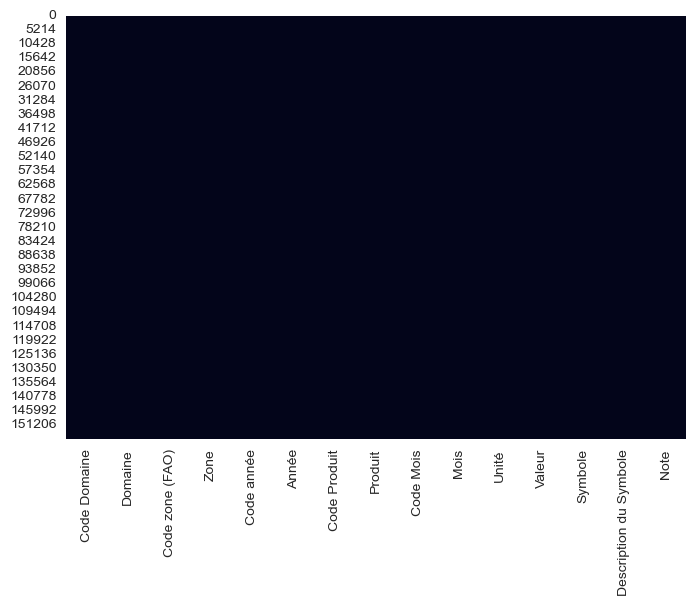

In [7]:
exploration(PouvoirAchat)
explo(PouvoirAchat)

<div style="text-align: justify"> La table Pouvoir achat fournis les informations sur le pouvoir d'achat de la population mondiale entre 2001 et 2021 dans la volaille de façon mensuel mois par mois. On retrouve les données de près de 204 pays sur le pourcentage d'inflation du prix alimentaire ainsi que l'indice du prix à la consommation alimentaire. Cet indice mesure l'évolution générale des prix utilisés ou payés par les ménages pour leur propre consommation. 
elle prend pour référence l'année 2015 afin de comparer son évolution depuis cette année de référence. Par exemple, l'Afghanistan a un indice de pouvoir d'achat alimentaire de 127.06 ce qui signifie une augmentation des dépenses de 27.06% depuis 2015.
<br>
On n'y retrouve pas de doublon ni de valeurs manquantes sur les variables essentielles à l'analyse.  </div

In [8]:
PrixProduction.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Code Mois,Mois,Unité,Valeur,Symbole,Description du Symbole
0,PP,Prix à la Production,2,Afghanistan,5539,Indice des prix à la production (2014-2016 = 100),1058,"Viande, volaille",1991,1991,7021,Valeur annuel,NaN,11.85,Im,Données de la FAO basées sur une méthodologie ...


ANALYSE STRUCTURE de la table ['PrixProduction']
 Taille:(5675, 16)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5675 entries, 0 to 5674
Data columns (total 16 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Code Domaine            5675 non-null   object 
 1   Domaine                 5675 non-null   object 
 2   Code zone (FAO)         5675 non-null   int64  
 3   Zone                    5675 non-null   object 
 4   Code Élément            5675 non-null   int64  
 5   Élément                 5675 non-null   object 
 6   Code Produit            5675 non-null   int64  
 7   Produit                 5675 non-null   object 
 8   Code année              5675 non-null   int64  
 9   Année                   5675 non-null   int64  
 10  Code Mois               5675 non-null   int64  
 11  Mois                    5675 non-null   object 
 12  Unité                   1492 non-null   object 
 13  Val

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Code Mois,Mois,Unité,Valeur,Symbole,Description du Symbole
count,5675,5675,5675.000000,5675,5675.000000,5675,5675.0,5675,5675.000000,5675.000000,5675.0,5675,1492,5675.000000,4193,5675
unique,1,1,NaN,144,NaN,2,NaN,1,NaN,NaN,NaN,1,1,NaN,2,3
top,PP,Prix à la Production,NaN,France,NaN,Indice des prix à la production (2014-2016 = 100),NaN,"Viande, volaille",NaN,NaN,NaN,Valeur annuel,USD,NaN,Im,Données de la FAO basées sur une méthodologie ...
freq,5675,5675,NaN,61,NaN,4183,NaN,5675,NaN,NaN,NaN,5675,1492,NaN,4183,4183
mean,NaN,NaN,119.180088,NaN,5537.159648,NaN,1058.0,NaN,2006.111542,2006.111542,7021.0,NaN,NaN,639.895478,NaN,NaN
std,NaN,NaN,73.335089,NaN,3.081760,NaN,0.0,NaN,8.730549,8.730549,0.0,NaN,NaN,1096.042107,NaN,NaN
min,NaN,NaN,1.000000,NaN,5532.000000,NaN,1058.0,NaN,1991.000000,1991.000000,7021.0,NaN,NaN,0.000000,NaN,NaN
25%,NaN,NaN,54.000000,NaN,5532.000000,NaN,1058.0,NaN,1999.000000,1999.000000,7021.0,NaN,NaN,64.740000,NaN,NaN
50%,NaN,NaN,115.000000,NaN,5539.000000,NaN,1058.0,NaN,2006.000000,2006.000000,7021.0,NaN,NaN,96.140000,NaN,NaN
75%,NaN,NaN,178.000000,NaN,5539.000000,NaN,1058.0,NaN,2014.000000,2014.000000,7021.0,NaN,NaN,1000.800000,NaN,NaN


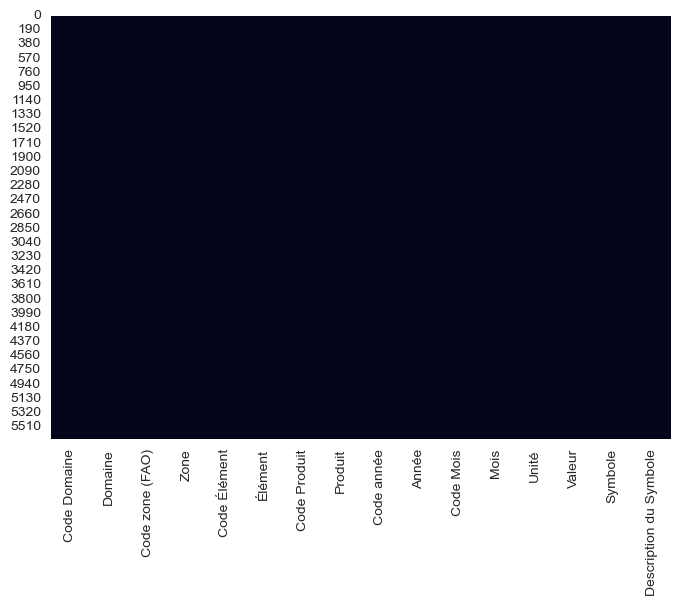

In [9]:
exploration(PrixProduction)
explo(PrixProduction)

<div style="text-align: justify"> La table Prix Production fournis des informations sur le prix de production annuel de volaille de 144 pays entre 1991 et 2021. 
<br>
On y retrouve le prix USD de la production en tonne sur une année ainsi que l'indice des prix à la production. L'indice mesure la variation annuelle moyenne des prix de vente perçus par les agriculteurs avec 2014-2016 comme année de référence. Par exemple, l'Afghanistan a un indice de prix de production de 89.10 ce qui signifie une diminution des coûts de production de 10.9% depuis 2014-2016.
<br>
On n'y retrouve pas de doublon ni de valeurs manquantes sur les variables essentielles à l'analyse.</div

In [10]:
indiceCom.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit (FAO),Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole
0,TI,Indices commerciaux,2,Afghanistan,64,Valeur des importations - Quantité période de ...,1058,"Viande, volaille",1984,1984,1000 $,24161,Fc,Donnée calculée


ANALYSE STRUCTURE de la table ['indiceCom']
 Taille:(42517, 14)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42517 entries, 0 to 42516
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   Code Domaine            42517 non-null  object
 1   Domaine                 42517 non-null  object
 2   Code zone (FAO)         42517 non-null  int64 
 3   Zone                    42517 non-null  object
 4   Code Élément            42517 non-null  int64 
 5   Élément                 42517 non-null  object
 6   Code Produit (FAO)      42517 non-null  int64 
 7   Produit                 42517 non-null  object
 8   Code année              42517 non-null  int64 
 9   Année                   42517 non-null  int64 
 10  Unité                   42517 non-null  object
 11  Valeur                  42517 non-null  int64 
 12  Symbole                 42517 non-null  object
 13  Description du Symbo

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit (FAO),Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole
count,42517,42517,42517.000000,42517,42517.000000,42517,42517.0,42517,42517.000000,42517.000000,42517,4.251700e+04,42517,42517
unique,1,1,NaN,194,NaN,5,NaN,1,NaN,NaN,2,NaN,1,1
top,TI,Indices commerciaux,NaN,Fidji,NaN,Indice de valeur des importations (2014-2016 =...,NaN,"Viande, volaille",NaN,NaN,indice,NaN,Fc,Donnée calculée
freq,42517,42517,NaN,300,NaN,8545,NaN,42517,NaN,NaN,25531,NaN,42517,42517
mean,NaN,NaN,123.821624,NaN,304.193523,NaN,1058.0,NaN,1994.956229,1994.956229,NaN,3.584893e+04,NaN,NaN
std,NaN,NaN,72.410771,NaN,195.514196,NaN,0.0,NaN,16.770939,16.770939,NaN,1.519822e+05,NaN,NaN
min,NaN,NaN,1.000000,NaN,64.000000,NaN,1058.0,NaN,1961.000000,1961.000000,NaN,0.000000e+00,NaN,NaN
25%,NaN,NaN,59.000000,NaN,65.000000,NaN,1058.0,NaN,1982.000000,1982.000000,NaN,3.100000e+01,NaN,NaN
50%,NaN,NaN,121.000000,NaN,462.000000,NaN,1058.0,NaN,1997.000000,1997.000000,NaN,9.900000e+01,NaN,NaN
75%,NaN,NaN,188.000000,NaN,464.000000,NaN,1058.0,NaN,2009.000000,2009.000000,NaN,3.870000e+03,NaN,NaN


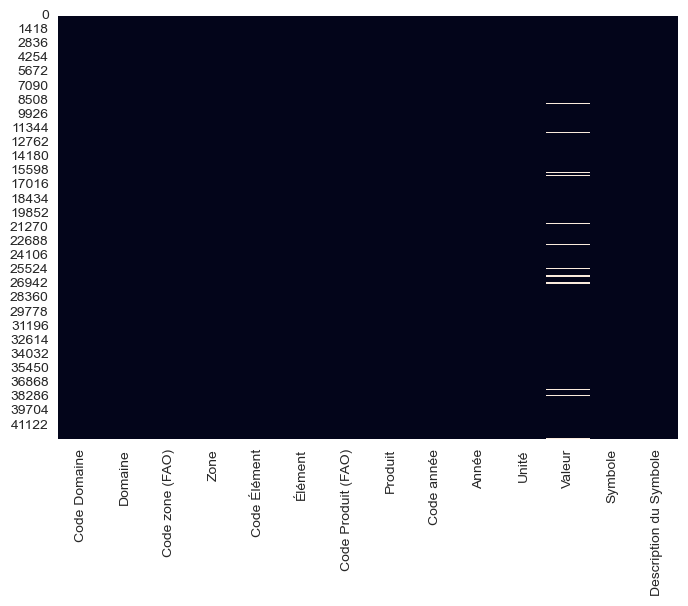

In [11]:
exploration(indiceCom)
explo(indiceCom)

<div style="text-align: justify"> La table Indice com fournis des informations sur le montant et la quantité des importations de volaille de près de 194 pays sur 60ans de 1961 à 2020. On y retrouve le prix en 1000 $, la quantité d'importation et leur valeur d'indices. Elles représentent les variations des valeurs unitaires des produits pondérées par les quantités entrant dans le commerce international dont la période de référence  est en 2014-2016. Par exemple, l'Afghanistan a un indice de prix de production de 89.0 ce qui signifie une diminution des importations de 11.0% depuis 2014-2016.
<br> 
On y retrouve aucune donnée Manquante ni doublon. Par contre, il y a un certain nombre de valeur à 0.0 dans la variable "Valeur". </div

In [12]:
PIB.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
0,MK,Indicateurs macro,2,Afghanistan,6110,Valeur US $,22008,Produit Intérieur Brut,1970,1970,millions,1731.435587,X,Sources internationales sûres,NaN


ANALYSE STRUCTURE de la table ['PIB']
 Taille:(96597, 15)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96597 entries, 0 to 96596
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Code Domaine            96597 non-null  object 
 1   Domaine                 96597 non-null  object 
 2   Code zone (FAO)         96597 non-null  int64  
 3   Zone                    96597 non-null  object 
 4   Code Élément            96597 non-null  int64  
 5   Élément                 96597 non-null  object 
 6   Code Produit            96597 non-null  int64  
 7   Produit                 96597 non-null  object 
 8   Code année              96597 non-null  int64  
 9   Année                   96597 non-null  int64  
 10  Unité                   96597 non-null  object 
 11  Valeur                  96597 non-null  float64
 12  Symbole                 96597 non-null  object 
 13  Description

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
count,96597,96597,96597.000000,96597,96597.000000,96597,96597.000000,96597,96597.000000,96597.000000,96597,9.659700e+04,96597,96597,0.0
unique,1,1,NaN,219,NaN,4,NaN,5,NaN,NaN,3,NaN,3,3,NaN
top,MK,Indicateurs macro,NaN,Équateur,NaN,Valeur US $,NaN,Produit Intérieur Brut,NaN,NaN,%,NaN,X,Sources internationales sûres,NaN
freq,96597,96597,NaN,604,NaN,33314,NaN,30606,NaN,NaN,42733,NaN,51069,51069,NaN
mean,NaN,NaN,129.246788,NaN,6117.568071,NaN,22012.817593,NaN,1996.514519,1996.514519,NaN,4.882560e+04,NaN,NaN,NaN
std,NaN,NaN,76.160217,NaN,9.307803,NaN,9.984384,NaN,14.548420,14.548420,NaN,4.895610e+05,NaN,NaN,NaN
min,NaN,NaN,1.000000,NaN,6103.000000,NaN,22008.000000,NaN,1970.000000,1970.000000,NaN,-9.683293e+01,NaN,NaN,NaN
25%,NaN,NaN,61.000000,NaN,6110.000000,NaN,22008.000000,NaN,1984.000000,1984.000000,NaN,1.320279e+01,NaN,NaN,NaN
50%,NaN,NaN,128.000000,NaN,6119.000000,NaN,22011.000000,NaN,1997.000000,1997.000000,NaN,2.256167e+02,NaN,NaN,NaN
75%,NaN,NaN,193.000000,NaN,6129.000000,NaN,22015.000000,NaN,2009.000000,2009.000000,NaN,4.645462e+03,NaN,NaN,NaN


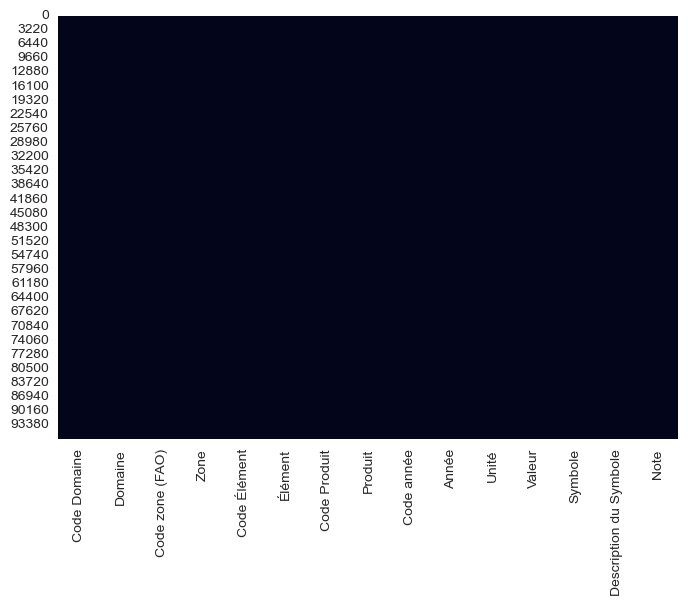

In [13]:
exploration(PIB)
explo(PIB)

<div style="text-align: justify"> La table PIB représente le PIB de 219 pays sur 51 ans de 1970 à 2020. Nous retrouvons le PIB total en million de $, le PIB par habitant et son taux de croissance. 
<br> 
On y retrouve aucune donnée Manquante ni doublon. </div

* [sommaire](#sommaire)

<a class="anchor" id="II.a.3"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Socio Culturel et Politique</h2>


In [14]:
popu.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
0,OA,Séries temporelles annuelles,2,Afghanistan,511,Population totale,3010,Population-Estimations,2012,2012,1000 personnes,30466.479,X,Ciffre de sources internationales,NaN


ANALYSE STRUCTURE de la table ['popu']
 Taille:(470, 15)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 470 entries, 0 to 469
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Code Domaine            470 non-null    object 
 1   Domaine                 470 non-null    object 
 2   Code zone (FAO)         470 non-null    int64  
 3   Zone                    470 non-null    object 
 4   Code Élément            470 non-null    int64  
 5   Élément                 470 non-null    object 
 6   Code Produit            470 non-null    int64  
 7   Produit                 470 non-null    object 
 8   Code année              470 non-null    int64  
 9   Année                   470 non-null    int64  
 10  Unité                   470 non-null    object 
 11  Valeur                  470 non-null    float64
 12  Symbole                 470 non-null    object 
 13  Description du S

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
count,470,470,470.000000,470,470.0,470,470.0,470,470.000000,470.000000,470,4.700000e+02,470,470,0.0
unique,1,1,NaN,235,NaN,1,NaN,1,NaN,NaN,1,NaN,1,1,NaN
top,OA,Séries temporelles annuelles,NaN,Afghanistan,NaN,Population totale,NaN,Population-Estimations,NaN,NaN,1000 personnes,NaN,X,Ciffre de sources internationales,NaN
freq,470,470,NaN,2,NaN,470,NaN,470,NaN,NaN,470,NaN,470,470,NaN
mean,NaN,NaN,135.217021,NaN,511.0,NaN,3010.0,NaN,2016.000000,2016.000000,NaN,3.798591e+04,NaN,NaN,NaN
std,NaN,NaN,78.971208,NaN,0.0,NaN,0.0,NaN,4.004262,4.004262,NaN,1.593289e+05,NaN,NaN,NaN
min,NaN,NaN,1.000000,NaN,511.0,NaN,3010.0,NaN,2012.000000,2012.000000,NaN,5.200000e-01,NaN,NaN,NaN
25%,NaN,NaN,68.250000,NaN,511.0,NaN,3010.0,NaN,2012.000000,2012.000000,NaN,4.038558e+02,NaN,NaN,NaN
50%,NaN,NaN,133.000000,NaN,511.0,NaN,3010.0,NaN,2016.000000,2016.000000,NaN,5.395144e+03,NaN,NaN,NaN
75%,NaN,NaN,198.750000,NaN,511.0,NaN,3010.0,NaN,2020.000000,2020.000000,NaN,2.117620e+04,NaN,NaN,NaN


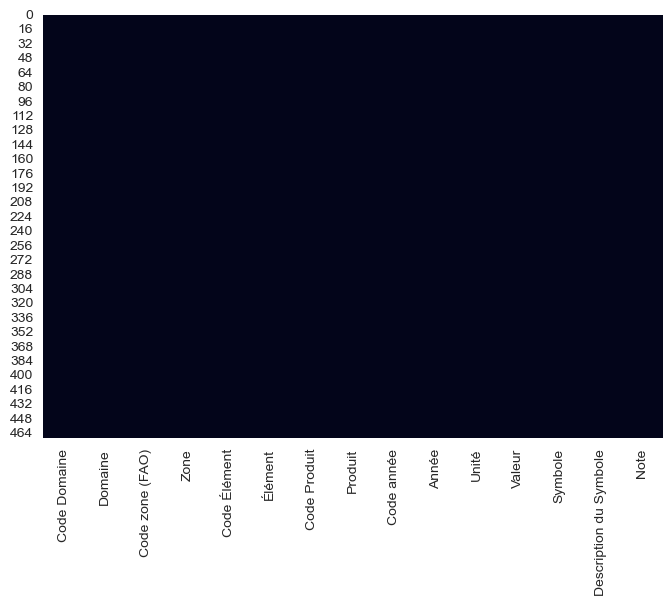

In [15]:
exploration(popu)
explo(popu)

<div style="text-align: justify"> La table Popu indique la taille de la population de 235 pays en 2012 et 2020 en milliers de personnes.
<br> 
On y retrouve aucune donnée Manquante ni doublon. </div

In [16]:
SecuAlim.head(1)

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
0,FS,Données de la sécurité alimentaire,2,Afghanistan,6121,Valeur,210041,Prévalence de la sous-alimentation (%) (moyenn...,20192021,2019-2021,%,29.8,E,Valeur estimée,NaN


ANALYSE STRUCTURE de la table ['SecuAlim']
 Taille:(919, 15)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 919 entries, 0 to 918
Data columns (total 15 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Code Domaine            919 non-null    object 
 1   Domaine                 919 non-null    object 
 2   Code zone (FAO)         919 non-null    int64  
 3   Zone                    919 non-null    object 
 4   Code Élément            919 non-null    int64  
 5   Élément                 919 non-null    object 
 6   Code Produit            919 non-null    int64  
 7   Produit                 919 non-null    object 
 8   Code année              919 non-null    int64  
 9   Année                   919 non-null    object 
 10  Unité                   919 non-null    object 
 11  Valeur                  793 non-null    object 
 12  Symbole                 919 non-null    object 
 13  Description 

,Code Domaine,Domaine,Code zone (FAO),Zone,Code Élément,Élément,Code Produit,Produit,Code année,Année,Unité,Valeur,Symbole,Description du Symbole,Note
count,919,919,919.000000,919,919.000000,919,919.000000,919,9.190000e+02,919,919,793,919,919,0.0
unique,1,1,NaN,204,NaN,1,NaN,7,NaN,2,3,317,3,3,NaN
top,FS,Données de la sécurité alimentaire,NaN,Afghanistan,NaN,Valeur,NaN,Prévalence de la sous-alimentation (%) (moyenn...,NaN,2020,%,<0.1,X,Ciffre de sources internationales,NaN
freq,919,919,NaN,5,NaN,919,NaN,204,NaN,511,360,93,509,509,NaN
mean,NaN,NaN,129.907508,NaN,6126.175190,NaN,137291.546246,NaN,8.965590e+06,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,77.135785,NaN,4.909951,NaN,92072.130048,NaN,1.003686e+07,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,1.000000,NaN,6121.000000,NaN,21032.000000,NaN,2.020000e+03,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,61.000000,NaN,6121.000000,NaN,21041.000000,NaN,2.020000e+03,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,128.000000,NaN,6125.000000,NaN,210011.000000,NaN,2.020000e+03,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,194.000000,NaN,6132.000000,NaN,210041.000000,NaN,2.019202e+07,NaN,NaN,NaN,NaN,NaN,NaN


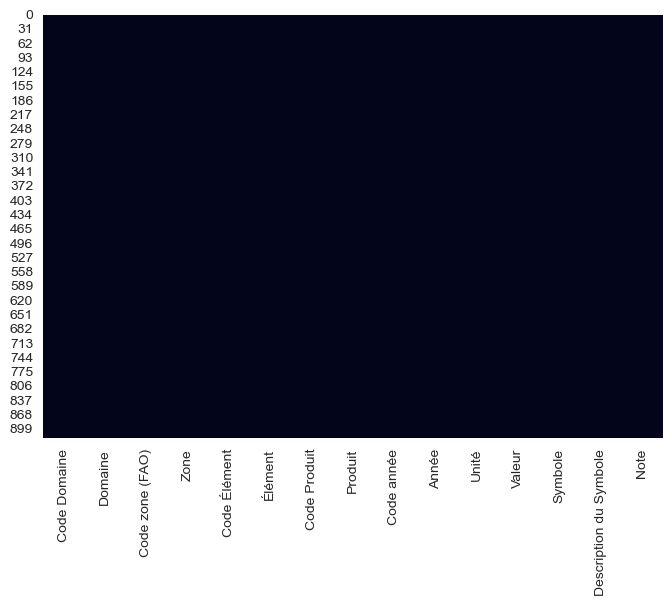

In [17]:
exploration(SecuAlim)
explo(SecuAlim)

<div style="text-align: justify"> La table Secu Alim nous informe sur diverses domaines entre 2019 et 2021 sur 204 pays. On retrouve le nombre de personnes en sous nutrition en millions, le nombre d'enfants de moins de 5 ans en excès pondéral en millions et la stabilité politique sous forme d'indice. 
<br>
On y retrouve aucun doublon. Par contre, nous retrouvons des valeurs manquantes dans la variable "Valeur". </div

* [sommaire](#sommaire)

<a class="anchor" id="II.a.4"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Ecologique</h2>


# Calcul de la distance des Pays par rapport à la France
dist=pd.read_excel("dist_cepii.xls")
ref= pd.read_excel("geo_cepii.xls")
dist.rename(columns={"iso_d":"iso3"}, inplace=True)
dist=pd.merge(dist, ref, on="iso3", how="outer", indicator=True)
dist=dist[dist["_merge"]=="both"]
dist= dist.drop(["_merge"],axis=1)
distFR=dist[dist["iso_o"]=="FRA"][["country","continent", "pays", "dist"]]
distFR.rename(columns={"pays":"Zone"}, inplace=True)
distFR=distFR.drop_duplicates()
distFR["country"].replace("Belgium and Luxembourg","Belgium",inplace=True)
distFR["country"].replace("Swaziland","Eswatini",inplace=True)
distFR["country"].replace("Libyan Arab Jamahiriya","Libya",inplace=True)
distFR["country"].replace("Congo (Democratic Republic of the)","Democratic Republic of the Congo",inplace=True)
distFR["country"].replace("Taiwan","China, Taiwan Province of",inplace=True)
distFR["country"].replace("China","China, mainland",inplace=True)
#distFR.to_csv('distance.csv', index=False, sep=",")

In [18]:
distance.head(1)

,country,continent,Zone,dist
0,Aruba,America,Aruba,7685.884


ANALYSE STRUCTURE de la table ['distance']
 Taille:(224, 4)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 224 entries, 0 to 223
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   country    224 non-null    object 
 1   continent  224 non-null    object 
 2   Zone       224 non-null    object 
 3   dist       224 non-null    float64
dtypes: float64(1), object(3)
memory usage: 7.1+ KB
None

Données Uniques: 
country 224 valeurs différentes

continent 5 valeurs différentes
 ['America' 'Asia' 'Africa' 'Europe' 'Pacific'] 

Zone 224 valeurs différentes

dist 224 valeurs différentes

None

Analyse Doublons: 
0

Données Manquantes: 
country      0.0
continent    0.0
Zone         0.0
dist         0.0
dtype: float64
AxesSubplot(0.125,0.11;0.775x0.77)

Analyse Globales & Heat map des valeurs manquantes: 


,country,continent,Zone,dist
count,224,224,224,224.000000
unique,224,5,224,NaN
top,Aruba,Africa,Aruba,NaN
freq,1,56,1,NaN
mean,NaN,NaN,NaN,6671.631547
std,NaN,NaN,NaN,4263.682062
min,NaN,NaN,NaN,262.384500
25%,NaN,NaN,NaN,3418.890500
50%,NaN,NaN,NaN,6552.276000
75%,NaN,NaN,NaN,8934.953500


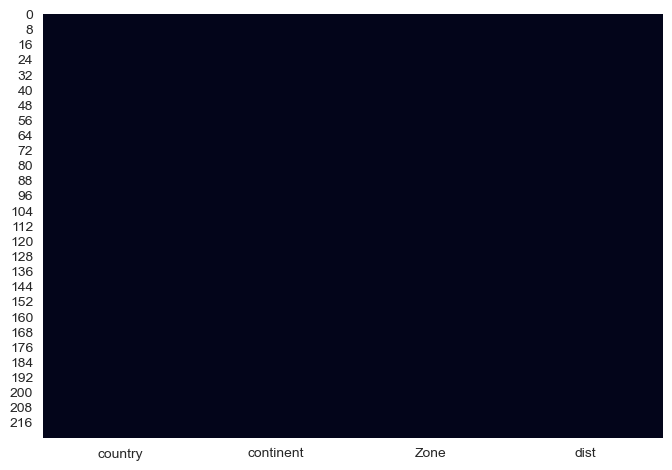

In [19]:
exploration(distance)
explo(distance)

<div style="text-align: justify"> J'ai importé les données de distance depuis le site http://www.cepii.fr/CEPII afin d'obtenir l'information de distance entre la France et les autres pays du mondes. La table Ref inclus les informations sur les différents pays (Clé primaire, nom FR et anglais, continent, language etc..). La table dist inclus les informations de distance entre les différents pays. J'ai joint les deux fichiers pour avoir toutes les informations. J'ai ensuite gardé que les informations concernant les distances par rapport à la France. 
J'ai enfin créé un nouveau fichier contenant ces données. "distance". </div 

In [20]:
Pays.head(1)

,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Item Code,Item,Year Code,Year,Unit,Value,Flag,Flag Description,Note
0,OA,Annual population,2,Afghanistan,511,Total Population - Both sexes,3010,Population - Est. & Proj.,2018,2018,1000 persons,37171.921,X,International reliable sources,NaN


ANALYSE STRUCTURE de la table ['Pays']
 Taille:(237, 15)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 237 entries, 0 to 236
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Domain Code       237 non-null    object 
 1   Domain            237 non-null    object 
 2   Area Code (FAO)   237 non-null    int64  
 3   Area              237 non-null    object 
 4   Element Code      237 non-null    int64  
 5   Element           237 non-null    object 
 6   Item Code         237 non-null    int64  
 7   Item              237 non-null    object 
 8   Year Code         237 non-null    int64  
 9   Year              237 non-null    int64  
 10  Unit              237 non-null    object 
 11  Value             237 non-null    float64
 12  Flag              237 non-null    object 
 13  Flag Description  237 non-null    object 
 14  Note              2 non-null      object 
dtypes: float64(1

,Domain Code,Domain,Area Code (FAO),Area,Element Code,Element,Item Code,Item,Year Code,Year,Unit,Value,Flag,Flag Description,Note
count,237,237,237.000000,237,237.0,237,237.0,237,237.0,237.0,237,2.370000e+02,237,237,2
unique,1,1,NaN,237,NaN,1,NaN,1,NaN,NaN,1,NaN,2,2,1
top,OA,Annual population,NaN,Afghanistan,NaN,Total Population - Both sexes,NaN,Population - Est. & Proj.,NaN,NaN,1000 persons,NaN,X,International reliable sources,"UNDESA, Population Division – World Population..."
freq,237,237,NaN,1,NaN,237,NaN,237,NaN,NaN,237,NaN,235,235,2
mean,NaN,NaN,135.805907,NaN,511.0,NaN,3010.0,NaN,2018.0,2018.0,NaN,3.835758e+04,NaN,NaN,NaN
std,NaN,NaN,79.135613,NaN,0.0,NaN,0.0,NaN,0.0,0.0,NaN,1.618162e+05,NaN,NaN,NaN
min,NaN,NaN,1.000000,NaN,511.0,NaN,3010.0,NaN,2018.0,2018.0,NaN,8.010000e-01,NaN,NaN,NaN
25%,NaN,NaN,69.000000,NaN,511.0,NaN,3010.0,NaN,2018.0,2018.0,NaN,3.856370e+02,NaN,NaN,NaN
50%,NaN,NaN,134.000000,NaN,511.0,NaN,3010.0,NaN,2018.0,2018.0,NaN,5.337962e+03,NaN,NaN,NaN
75%,NaN,NaN,199.000000,NaN,511.0,NaN,3010.0,NaN,2018.0,2018.0,NaN,1.975147e+04,NaN,NaN,NaN


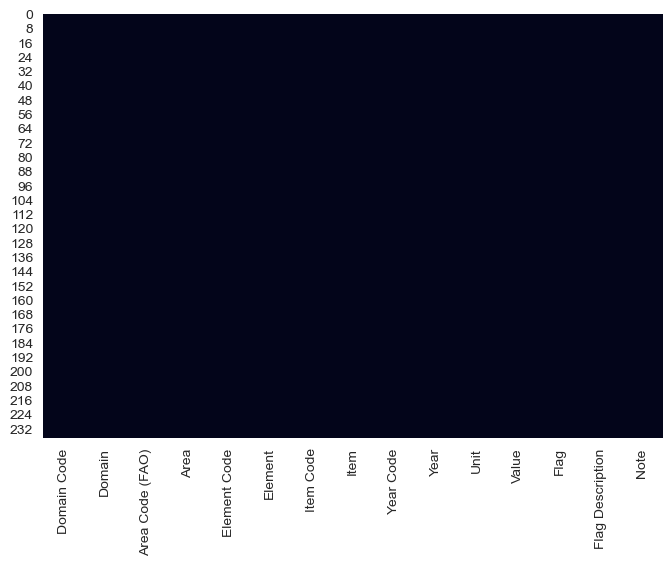

In [21]:
exploration(Pays)
explo(Pays)

<div style="text-align: justify"> La table Pays permet d'obtenir la clé primaire sur le système FAO ainsi que le nom anglais de tous les pays afin de pouvoir joindre  facilement les différentes tables d'origine FAO avec la table distance. Cette table provient de la table population dont j'ai gardé seulement les colonnes des pays en français, anglais et la clé du système FAO. </div

* [sommaire](#sommaire)

# III. Nettoyage des données <a class="anchor" id="III"></a>

<div style="background-color: #F56086;">
    <a class="anchor" id="III.a"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">a) Création des valeurs calculées</h2>
</div>

<a class="anchor" id="III.a.1"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Table Population</h2>




In [22]:
# Rajouter les noms Anglais des pays dans la table population
Pays=Pays[["Area","Area Code (FAO)"]]

p=pd.merge(Pays, popu, 
           left_on="Area Code (FAO)", 
           right_on="Code zone (FAO)", 
           how='outer', 
           indicator=True)

print(p[p["_merge"]=="right_only"])

popu= p.drop(["_merge"],axis=1)

Empty DataFrame
Columns: [Area, Area Code (FAO), Code Domaine, Domaine, Code zone (FAO), Zone, Code Élément, Élément, Code Produit, Produit, Code année, Année, Unité, Valeur, Symbole, Description du Symbole, Note, _merge]
Index: []


In [23]:
popu["Année"]= popu["Année"].astype("str")

# Transposer la table Popu sur la variable Année. 
popu=popu.pivot_table(index=["Area", "Zone", "Code zone (FAO)"],
                columns=["Année"],
                values="Valeur").reset_index()

# Calcul l'évolution de la population de chaque entre 2012 et 2020. 
popu["evolution8an%"]= round(((popu["2020.0"]-popu["2012.0"])/popu["2012.0"])*100, 3)


In [24]:
popu.isna().mean()

Année
Area               0.0
Zone               0.0
Code zone (FAO)    0.0
2012.0             0.0
2020.0             0.0
evolution8an%      0.0
dtype: float64

* [sommaire](#sommaire)

<a class="anchor" id="III.a.3"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Table Prix production</h2>




In [25]:
# conserver que l'année 2020 pour le prix de production
PrixProduction = PrixProduction[PrixProduction["Année"]==2020]

# Je transpose la table prix Production sur les éléments (Prix de productions)
PrixProductions=PrixProduction.pivot_table(index=["Zone","Code zone (FAO)"],
                columns=["Élément"],
                values="Valeur").reset_index()

In [26]:
explo(PrixProductions)

Élément,Zone,Code zone (FAO),Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne)
count,142,142.000000,142.000000,36.000000
unique,142,NaN,NaN,NaN
top,Afghanistan,NaN,NaN,NaN
freq,1,NaN,NaN,NaN
mean,NaN,122.795775,115.790775,2583.502778
std,NaN,73.469204,38.810544,1488.857794
min,NaN,1.000000,56.860000,637.900000
25%,NaN,58.250000,94.040000,1597.425000
50%,NaN,118.000000,107.125000,1954.450000
75%,NaN,178.750000,125.197500,3037.250000


In [27]:
PrixProductions.isna().mean()

Élément
Zone                                                 0.000000
Code zone (FAO)                                      0.000000
Indice des prix à la production (2014-2016 = 100)    0.000000
Prix à la Production (USD/tonne)                     0.746479
dtype: float64

In [28]:
# Calcul de l'indice de l'évolution des prix de production avec la France en Référence afin de déterminer les pays ayant une plus forte évolution de coût de production que la France.
PrixProduction= PrixProductions.fillna(PrixProductions["Prix à la Production (USD/tonne)"].median()) # ne me servira pas à l'analyse car il ya trop d'informations manquantes
PrixFR=PrixProduction[PrixProduction["Zone"]=="France"]
PrixProduction["Indice Evol prix production (France=100)"] = round(
    (PrixProduction["Indice des prix à la production (2014-2016 = 100)"]/ float(PrixFR["Indice des prix à la production (2014-2016 = 100)"])
    )*100, 2)



* [sommaire](#sommaire)

<a class="anchor" id="III.a.2"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Table Disponibilité</h2>




In [29]:
# Calculer le Taux de dépendance à l'importation de volaille
dispo = disp.copy()
poule=dispo[dispo["Produit"]=="Viande de Volailles"]
poule=poule[["Zone", "Élément", "Valeur"]]
poule= poule.pivot_table(index=['Zone'], 
                         columns=["Élément"], 
                         values="Valeur").reset_index()
poulet= poule.fillna(0.0)  # pour pouvoir calculer le le taux de dépendance car si pas info possible pas importation ou exportation
poulet['Txdependance']= (poulet['Importations - Quantité']/(poulet['Production']+ poulet['Importations - Quantité']- poulet['Exportations - Quantité']))*100
poulet['TxAutosuffisance']= (poulet['Production']/(poulet['Production']+ poulet['Importations - Quantité']- poulet['Exportations - Quantité']))*100
poulet=poulet[["Zone","Txdependance"]]


In [30]:
# Calcul de la part de consommation de volaille sur la viande et sur le total Plutot végétarien ?  en 2019
dispoT2=dispo2[dispo2["Élément"]=="Nourriture"]
dispoT2= dispoT2.groupby("Zone").agg({"Valeur": lambda x: x.sum() }).reset_index()
dispoT2= dispoT2.rename(columns={"Valeur":"Alim_total2019"})
listproteine=('Viande de Bovins', "Viande d'Ovins/Caprins", 'Viande de Suides',
 'Viande de Volailles', 'Viande, Autre', 'Abats Comestible' ,
'Oeufs',  'Poissons Eau Douce', 'Poissons Pelagiques', 'Poissons Marins, Autres', 'Crustacés', 
              'Cephalopodes', 'Mollusques, Autres', 'Animaux Aquatiques Autre', 'Viande de Anim Aquatiq')
dispoprot2=dispo2[dispo2['Produit'].isin(listproteine)]
dispon2=dispoprot2[dispoprot2["Élément"]=="Nourriture"]
dispon2= dispon2.groupby("Zone").agg({"Valeur": lambda x: x.sum() }).reset_index()
dispon2= dispon2.rename(columns={"Valeur":"viande_total2019"})
Anviandes2=dispoT2.merge(dispon2, on="Zone", how='outer')
volaille2= dispo2[(dispo2["Élément"]=="Nourriture") &(dispo2["Produit"]=="Viande de Volailles")][["Zone", "Valeur" ]]
volaille2= volaille2.rename(columns={"Valeur":"volaille2019"})

viandes2=Anviandes2.merge(volaille2, on="Zone", how='outer')

In [31]:
# Calcul de la part de consommation de volaille sur la viande et sur le total Plutot végétarien en 2020
dispoT=dispo[dispo["Élément"]=="Nourriture"]
dispoT= dispoT.groupby("Zone").agg({"Valeur": lambda x: x.sum() }).reset_index()
dispoT= dispoT.rename(columns={"Valeur":"Alim_total"})
listproteine=('Viande de Bovins', "Viande d'Ovins/Caprins", 'Viande de Suides',
 'Viande de Volailles', 'Viande, Autre', 'Abats Comestible' ,
'Oeufs',  'Poissons Eau Douce', 'Poissons Pelagiques', 'Poissons Marins, Autres', 'Crustacés', 
              'Cephalopodes', 'Mollusques, Autres', 'Animaux Aquatiques Autre', 'Viande de Anim Aquatiq')
dispoprot=dispo[dispo['Produit'].isin(listproteine)]
dispon=dispoprot[dispoprot["Élément"]=="Nourriture"]
dispon= dispon.groupby("Zone").agg({"Valeur": lambda x: x.sum() }).reset_index()
dispon= dispon.rename(columns={"Valeur":"viande_total"})
Anviandes=dispoT.merge(dispon, on="Zone", how='outer')
volaille= dispo[(dispo["Élément"]=="Nourriture") &(dispo["Produit"]=="Viande de Volailles")][["Zone", "Valeur" ]]
volaille= volaille.rename(columns={"Valeur":"volaille"})

viandes=Anviandes.merge(volaille, on="Zone", how='outer')

viandes["%ViandesurNourriture"] = round((viandes.viande_total / viandes.Alim_total), 3)
viandes.head()
viandes["%VolaillesurViandes"] = round((viandes.volaille / viandes.viande_total), 3)
viandes.head()
viandes["%VolaillesurNourriture"] = round((viandes.volaille / viandes.Alim_total), 3)

In [32]:
# Calcul évolution part conso Viande et Volaille entre 2019 et 2020
Evol=viandes.merge(viandes2, on="Zone", how= 'left')
Evol["Evolviande_total1ans"]= ((Evol.viande_total-Evol.viande_total2019)/Evol.viande_total2019)
Evol["Evolvolaille1ans"]= ((Evol.volaille-Evol.volaille2019)/Evol.volaille2019)

viandes= Evol[["Zone","volaille", "%ViandesurNourriture","%VolaillesurViandes","%VolaillesurNourriture", "Evolviande_total1ans", "Evolvolaille1ans"    ]]

* [sommaire](#sommaire)

<div style="background-color: #F56086;">
    <a class="anchor" id="III.b"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">b) Nettoyage et Formatage Valeurs</h2>
</div>

<a class="anchor" id="III.b.1"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Modification des Valeurs</h2>




In [33]:
# garde que la disponibilité protéine de la table Dispo et la viande de volaille
ndispo=dispo[dispo['Élément']=="Disponibilité de protéines en quantité (g/personne/jour)"]
dispo=ndispo[ndispo['Produit']=="Viande de Volailles"]

In [34]:
# conserver que l'année 2020 pour le pouvoir d'achat
PouvoirAchat = PouvoirAchat[PouvoirAchat["Année"]==2020]

In [35]:
# conserver que l'année 2020 pour les informations d'importations
indiceCom = indiceCom[indiceCom["Année"]==2020]

In [36]:
# Conserver que l'année 2020 pour juste le PIB 
PIB= PIB[PIB["Produit"]=="Produit Intérieur Brut"]
PIB= PIB[PIB["Année"]==2020]

In [37]:
# Conserver que l'année 2020 et suppression des informations sur la sous nutrition.
SecuAlim =SecuAlim[SecuAlim["Année"]=='2020']

com=("Nombre de personnes sous-alimentées (millions) (valeur annuelle)", "Prévalence de la sous-alimentation (%) (valeur annuelle)" )
SecuAlim=SecuAlim[~SecuAlim["Produit"].isin(com)]


In [38]:
# Remplacer le nom des pays anglais pour pouvoir correspondre avec la table distance
dict_country = {"Bolivia (Plurinational State of)":"Bolivia", 
                "Cabo Verde":"Cape Verde", 
                "China, Hong Kong SAR":"Hong Kong", 
                "China, Macao SAR":"Macau (Aomen)", 
                "Czechia":"Czech Republic", 
                "Democratic People's Republic of Korea":"Korea, Dem. People's Rep. of", 
                "Iran (Islamic Republic of)":"Iran", 
                "Kazakhstan":"Kazakstan",
                "Montenegro":"Serbia and Montenegro", 
                "Myanmar":"Burma", 
                "North Macedonia":"Macedonia (the former Yugoslav Rep. of)", 
                "Republic of Korea":"Korea", 
                "Republic of Moldova":"Moldova, Rep.of", 
                "Serbia":"Serbia and Montenegro", 
                "Timor-Leste":"East Timor", 
                "Türkiye":"Turkey", 
                "United Kingdom of Great Britain and Northern Ireland":"United Kingdom", 
                "United Republic of Tanzania":"Tanzania, United Rep. of ", 
                "Venezuela (Bolivarian Republic of)":"Venezuela"} 
popu = popu.replace({"Area":dict_country})

#Réduire l'influence de la population grâce au Logarithme
popu["Populationlog"] =np.log(popu["2020.0"])

In [39]:
distance['dist']= distance.dist * -1

J'ai multiplié par -1 la distance pour que les distances soient négatives car plus le pays est éloigné moins l'exportation sera intéressante pour 
l'entreprise. 

* [sommaire](#sommaire)

<a class="anchor" id="III.b.2"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Modification des colonnes</h2>




In [40]:
# Je transpose la table dispo sur les Éléments (importations, exportation, Disponibilités etc..)
dispo=dispo.pivot_table(index=["Zone", "Code zone (FAO)"], 
                        columns=["Élément"], 
                        values="Valeur")

In [41]:
# Je transpose la table Pouvoir d'achat sur les Produits (Prix à la consommation) et Log sur Indice Pouvoir Achat
# information mois par mois. je sélectionne l'information moyenne sur les 12 mois
PouvoirAchat=PouvoirAchat.pivot_table(index=["Zone","Code zone (FAO)"],
                columns=["Produit"],
                values="Valeur", 
                 aggfunc='mean').reset_index()

PouvoirAchat=PouvoirAchat.rename(columns={"Prix à la Consommation, Indices d'alimentation (2015 = 100)":"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)"})

PouvoirAchat["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log"] =np.log(PouvoirAchat["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)"])


In [42]:
# Je transpose la table Indice com sur les éléments (importations, exportations etc...) et log les valeurs d'importations
indiceCom=indiceCom.pivot_table(index=["Zone","Code zone (FAO)"],
                columns=["Élément"],
                values="Valeur").reset_index()

indiceCom["Valeur des importations - Prix période de référence log"] =np.log(indiceCom["Valeur des importations - Prix période de référence"])
indiceCom["Valeur des importations - Quantité période de référence log"] =np.log(indiceCom["Valeur des importations - Quantité période de référence"])

In [43]:
# Je transpose la table PIB sur les éléments (PIB) et Log le PIB par hab 
PIB=PIB.pivot_table(index=["Zone","Code zone (FAO)"],
                columns=["Élément"],
                values="Valeur").reset_index()

PIB["Valeur US $ par habitant log"] =np.log(PIB["Valeur US $ par habitant"])

In [44]:
# J'ai supprimé la colonne sur la population 2012
popu = popu[["Code zone (FAO)","Area", "Zone", "2020.0", "evolution8an%","Populationlog" ]]
popu= popu.rename(columns={ "2020.0":"Population"})

ANALYSE STRUCTURE de la table ['SecuAlim']
 Taille:(201, 5)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 201 entries, 0 to 200
Data columns (total 5 columns):
 #   Column                                                                                             Non-Null Count  Dtype  
---  ------                                                                                             --------------  -----  
 0   Zone                                                                                               201 non-null    object 
 1   Code zone (FAO)                                                                                    201 non-null    int64  
 2   Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)  201 non-null    float64
 3   Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)          201 non-null    float64
 4   Stabilité politique et absence de violenc

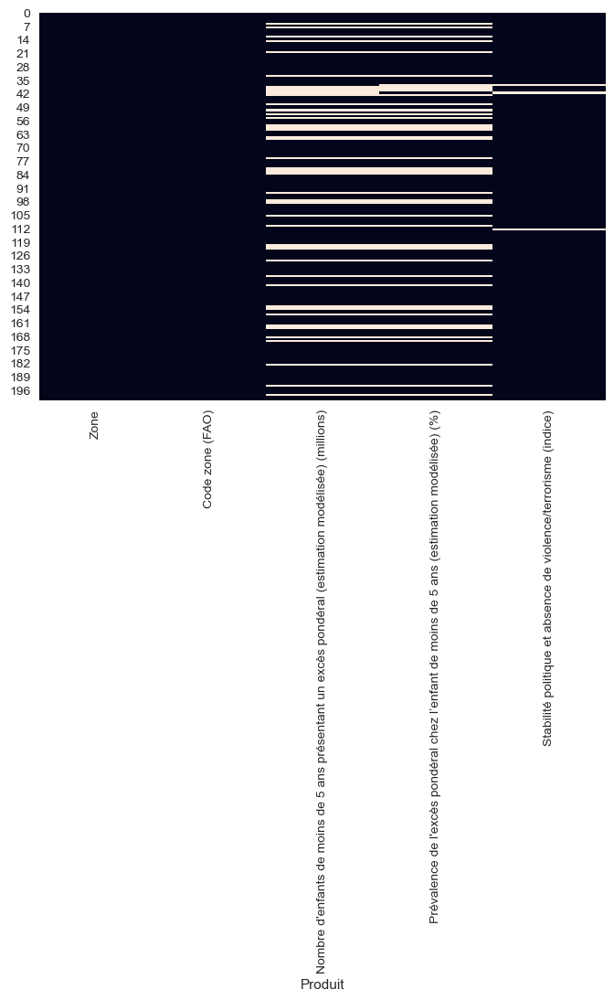

In [45]:
# Je transpose la table SecuAlim sur les produits (stabilité politique, excès pondéral)
SecuAlim= SecuAlim.pivot_table(index=["Zone","Code zone (FAO)"],
                columns=["Produit"],
                values="Valeur", aggfunc='sum').reset_index()

# j'ai remplacé les Nan par 0.0 car on n'a pas d'information sur ces données pour pouvoir modifier les types de données
SecuAlim=SecuAlim.fillna(0.0)
SecuAlim=SecuAlim.replace("<0.1",0.001)

#J'ai modifié les types de données en numeric pour pouvoir appliquer une analyse.
SecuAlim["Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)"]=pd.to_numeric(SecuAlim["Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)"])
SecuAlim["Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)"]=pd.to_numeric(SecuAlim["Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)"])
SecuAlim["Stabilité politique et absence de violence/terrorisme (indice)"]=pd.to_numeric(SecuAlim["Stabilité politique et absence de violence/terrorisme (indice)"])

exploration(SecuAlim)



In [46]:
# Suppression des colonnes en doubles
distance.drop(["Zone"], axis=1, inplace=True)

In [47]:
liste= (dispo,PouvoirAchat,indiceCom,PIB ,popu, SecuAlim,distance  )
for i in liste:
    print(i.isna().mean())

Élément
Disponibilité de protéines en quantité (g/personne/jour)    0.0
dtype: float64
Produit
Zone                                                               0.000000
Code zone (FAO)                                                    0.000000
Food price inflation                                               0.014778
Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)        0.014778
Prix à la Consommation, Indices généraux (2015 = 100)              0.000000
Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log    0.014778
dtype: float64
Élément
Zone                                                           0.000000
Code zone (FAO)                                                0.000000
Indice de quantité d'importation (2014-2016 = 100)             0.010363
Indice de valeur des importations (2014-2016 = 100)            0.000000
Indice de valeur unitaire à l'import (2014-2016 = 100)         0.010363
Valeur des importations - Prix période de référence            0.0

* [sommaire](#sommaire)

<div style="background-color: #F56086;">
    <a class="anchor" id="III.c"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">c) Jointure</h2>
</div>

In [48]:
dispo=pd.merge(dispo, poulet, on=["Zone"], how='outer', indicator=True)
print(dispo[dispo["_merge"]=="left_only"].shape[0], "mal jointée à gauche dispo")
print(dispo[dispo["_merge"]=="right_only"].shape[0], "mal jointée à droite dispo")
dispo= dispo.drop(["_merge"],axis=1)

dispoviande=dispo.merge(viandes, on="Zone", how='outer', indicator=True)
print(dispoviande[dispoviande["_merge"]=="left_only"].shape[0], "mal jointée à gauche dispoviande")
print(dispoviande[dispoviande["_merge"]=="right_only"].shape[0], "mal jointée à droite dispoviande")
dispoviande= dispoviande.drop(["_merge"],axis=1)
dispoviande.head(1)

0 mal jointée à gauche dispo
0 mal jointée à droite dispo
0 mal jointée à gauche dispoviande
0 mal jointée à droite dispoviande


,Zone,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans
0,Afghanistan,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986


<div style="text-align: justify"> J'ai d'abord joint la table dispo avec la table poulet puis joindre le résultat avec la table viandes. <br> Toutes les valeurs ont bien été jointé. </div

In [49]:
popalim=pd.merge(popu, dispoviande, on="Zone", how='outer', indicator=True)
print(popalim[popalim["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(popalim[popalim["_merge"]=="left_only"].shape[0], "mal jointée à gauche")

etud1=popalim[popalim["_merge"]=="both"]
etud1= etud1.drop(["_merge","Code zone (FAO)"],axis=1)
etud1.head(1)

0 mal jointée à droite
49 mal jointée à gauche


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986


<div style="text-align: justify"> J'ai ensuite rajouté la table Population. <br> 49 pays présents dans la table population n'avaient pas d'informations au niveau de leur consommation de volaille. J'ai décidé de ne pas garder ces pays.  </div

In [50]:
etud2=pd.merge(etud1, PouvoirAchat, on="Zone", how='outer', indicator=True)
print(etud2[etud2["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etud2[etud2["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etud2[etud2["_merge"]=="left_only"][["Zone"]])

etud2=etud2[(etud2["_merge"]=="both") | (etud2["_merge"]=="left_only")]
etud2= etud2.drop(["_merge","Code zone (FAO)"],axis=1)

etud2['Food price inflation']= etud2['Food price inflation'].fillna(etud2['Food price inflation'].median())
etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)"]= etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)"].fillna(etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)"].median())
etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log"]= etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log"].fillna(etud2["Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log"].median())

etud2["Prix à la Consommation, Indices généraux (2015 = 100)"]= etud2["Prix à la Consommation, Indices généraux (2015 = 100)"].fillna(etud2["Prix à la Consommation, Indices généraux (2015 = 100)"].median())

etud2.head(1)

23 mal jointée à droite
6 mal jointée à gauche
                                           Zone
33                                        Chine
36                    Chine, Taiwan Province de
43                                         Cuba
47   République populaire démocratique de Corée
117                                       Nauru
170                                Turkménistan


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log"
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897


<div style="text-align: justify"> J'ai ensuite rajouté la table Pouvoir d'achat. 
<br> 23 pays présents dans la table pouvoir d'achat n'ont pas d'information sur la consommation de volaille. Je ne garderais pas ces pays là. 
<br> 6 pays présents n'ont pas  l'information pouvoir d'achat. J'ai rajouté à la place des valeurs médianes qui n'influenceront pas trop le jeu de données. </div

In [51]:
etud3=pd.merge(etud2, PrixProduction, on="Zone", how='outer', indicator=True)
print(etud3[etud3["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etud3[etud3["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etud3[etud3["_merge"]=="left_only"][["Zone"]])

etud3=etud3[(etud3["_merge"]=="both") | (etud3["_merge"]=="left_only")]
etud3= etud3.drop(["_merge","Code zone (FAO)"],axis=1)
etud3['Indice des prix à la production (2014-2016 = 100)']= etud3['Indice des prix à la production (2014-2016 = 100)'].fillna(etud3['Indice des prix à la production (2014-2016 = 100)'].median())
etud3["Prix à la Production (USD/tonne)"]= etud3["Prix à la Production (USD/tonne)"].fillna(etud3["Prix à la Production (USD/tonne)"].median())
etud3["Indice Evol prix production (France=100)"]= etud3["Indice Evol prix production (France=100)"].fillna(etud3["Indice Evol prix production (France=100)"].median())


etud3.head(1)

7 mal jointée à droite
51 mal jointée à gauche
                                           Zone
3                                        Angola
10                                      Bahamas
11                                      Bahreïn
17                                        Bénin
21                                     Botswana
30                    République centrafricaine
33                                        Chine
35                         Chine - RAS de Macao
36                    Chine, Taiwan Province de
39                                      Comores
47   République populaire démocratique de Corée
48             République démocratique du Congo
50                                     Djibouti
51                                    Dominique
57                                     Eswatini
62                          Polynésie française
63                                        Gabon
70                                    Guatemala
73                                       

,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100)
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897,89.1,1954.45,87.09


<div style="text-align: justify"> J'ai ensuite rajouté la table Prix de production. <br>
7 pays présents dans la table Prix de production n'ont pas d'information sur la consommation de volaille. Je ne garderais pas ces pays là. <br>
51 pays présents n'ont pas l'information sur le coût de production. J'ai rajouté à la place des valeurs médianes qui n'influenceront pas trop le jeu de données. Au vu du nombre de données manquantes, ces variables ne seront pas inclus dans l'analyse. </div

In [52]:
etud4=pd.merge(etud3, indiceCom, on="Zone", how='outer', indicator=True)
print(etud4[etud4["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etud4[etud4["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etud4[etud4["_merge"]=="left_only"][["Zone"]])

etud4=etud4[(etud4["_merge"]=="both") | (etud4["_merge"]=="left_only")]
etud4= etud4.drop(["_merge","Code zone (FAO)"],axis=1)
etud4["Indice de quantité d'importation (2014-2016 = 100)"]= etud4["Indice de quantité d'importation (2014-2016 = 100)"].fillna(etud4["Indice de quantité d'importation (2014-2016 = 100)"].median())
etud4["Indice de valeur des importations (2014-2016 = 100)"]= etud4["Indice de valeur des importations (2014-2016 = 100)"].fillna(etud4["Indice de valeur des importations (2014-2016 = 100)"].median())
etud4["Indice de valeur unitaire à l'import (2014-2016 = 100)"]= etud4["Indice de valeur unitaire à l'import (2014-2016 = 100)"].fillna(etud4["Indice de valeur unitaire à l'import (2014-2016 = 100)"].median())
etud4["Valeur des importations - Prix période de référence"]= etud4["Valeur des importations - Prix période de référence"].fillna(etud4["Valeur des importations - Prix période de référence"].median())
etud4["Valeur des importations - Quantité période de référence"]= etud4["Valeur des importations - Quantité période de référence"].fillna(etud4["Valeur des importations - Quantité période de référence"].median())
etud4["Valeur des importations - Prix période de référence log"]= etud4["Valeur des importations - Prix période de référence log"].fillna(etud4["Valeur des importations - Prix période de référence log"].median())
etud4["Valeur des importations - Quantité période de référence log"]= etud4["Valeur des importations - Quantité période de référence log"].fillna(etud4["Valeur des importations - Quantité période de référence log"].median())

etud4.head(1)

11 mal jointée à droite
4 mal jointée à gauche
                                           Zone
33                                        Chine
47   République populaire démocratique de Corée
110               Micronésie (États fédérés de)
118                                       Népal


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100),Indice de quantité d'importation (2014-2016 = 100),Indice de valeur des importations (2014-2016 = 100),Indice de valeur unitaire à l'import (2014-2016 = 100),Valeur des importations - Prix période de référence,Valeur des importations - Quantité période de référence,Valeur des importations - Prix période de référence log,Valeur des importations - Quantité période de référence log
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897,89.1,1954.45,87.09,89.0,81.0,92.0,45389.0,46241.0,10.723025,10.741622


<div style="text-align: justify"> J'ai ensuite rajouté la table Indice Com. <br>
11 pays présents dans la table Indice Com n'ont pas d'information sur la consommation de volaille. Je ne garderais pas ces pays là. <br>
4 pays présents n'ont pas l'information sur l'importation de la volaille. J'ai rajouté à la place des valeurs médianes qui n'influenceront pas trop le jeu de données. </div

In [53]:
etud5=pd.merge(etud4, PIB, on="Zone", how='outer', indicator=True)
print(etud5[etud5["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etud5[etud5["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etud5[etud5["_merge"]=="left_only"][["Zone"]])
etud5=etud5[(etud5["_merge"]=="both") | (etud5["_merge"]=="left_only")]
etud5= etud5.drop(["_merge","Code zone (FAO)"],axis=1)
etud5["Croissance annuelle US$"]= etud5["Croissance annuelle US$"].fillna(etud5["Croissance annuelle US$"].median())
etud5["Valeur US $"]= etud5["Valeur US $"].fillna(etud5["Valeur US $"].median())
etud5["Valeur US $ par habitant"]= etud5["Valeur US $ par habitant"].fillna(etud5["Valeur US $ par habitant"].median())
etud5["Valeur US $ par habitant log"]= etud5["Valeur US $ par habitant log"].fillna(etud5["Valeur US $ par habitant log"].median())

etud5.head(1)

26 mal jointée à droite
1 mal jointée à gauche
                         Zone
36  Chine, Taiwan Province de


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100),Indice de quantité d'importation (2014-2016 = 100),Indice de valeur des importations (2014-2016 = 100),Indice de valeur unitaire à l'import (2014-2016 = 100),Valeur des importations - Prix période de référence,Valeur des importations - Quantité période de référence,Valeur des importations - Prix période de référence log,Valeur des importations - Quantité période de référence log,Croissance annuelle US$,Valeur US $,Valeur US $ par habitant,Valeur US $ par habitant log
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897,89.1,1954.45,87.09,89.0,81.0,92.0,45389.0,46241.0,10.723025,10.741622,4.701381,19793.262413,508.453722,6.231374


<div style="text-align: justify"> J'ai ensuite rajouté la table PIB. <br>
26 pays présents dans la table PIB n'ont pas d'information sur la consommation de volaille. Je ne garderais pas ces pays là. <br>
1 pays présent n'a pas l'information sur l'importation de la volaille. J'ai rajouté à la place une valeur médiane qui n'influencera pas trop le jeu de données. </div

In [54]:
etud6=pd.merge(etud5, SecuAlim, on="Zone", how='outer', indicator=True)
print(etud6[etud6["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etud6[etud6["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etud6[etud6["_merge"]=="left_only"][["Zone"]])

etud6=etud6[(etud6["_merge"]=="both") | (etud6["_merge"]=="left_only")]
etud6= etud6.drop(["_merge","Code zone (FAO)"],axis=1)
etud6["Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)"]= etud6["Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)"].fillna(etud6["Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)"].median())
etud6["Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)"]= etud6["Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)"].fillna(etud6["Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)"].median())
etud6["Stabilité politique et absence de violence/terrorisme (indice)"]= etud6["Stabilité politique et absence de violence/terrorisme (indice)"].fillna(etud6["Stabilité politique et absence de violence/terrorisme (indice)"].median())

etud6.head(1)

17 mal jointée à droite
2 mal jointée à gauche
                    Zone
62   Polynésie française
120   Nouvelle-Calédonie


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100),Indice de quantité d'importation (2014-2016 = 100),Indice de valeur des importations (2014-2016 = 100),Indice de valeur unitaire à l'import (2014-2016 = 100),Valeur des importations - Prix période de référence,Valeur des importations - Quantité période de référence,Valeur des importations - Prix période de référence log,Valeur des importations - Quantité période de référence log,Croissance annuelle US$,Valeur US $,Valeur US $ par habitant,Valeur US $ par habitant log,Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions),Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%),Stabilité politique et absence de violence/terrorisme (indice)
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897,89.1,1954.45,87.09,89.0,81.0,92.0,45389.0,46241.0,10.723025,10.741622,4.701381,19793.262413,508.453722,6.231374,0.2,3.9,-2.73


<div style="text-align: justify"> J'ai ensuite rajouté la table SecuAlim. <br>
17 pays présents dans la table SecuAlim n'ont pas d'information sur la consommation de volaille. Je ne garderais pas ces pays là. <br>
2 pays présents n'ont pas l'information sur diverses données. J'ai rajouté à la place des valeurs médianes qui n'influenceront pas trop le jeu de données. </div

In [55]:
etuds=pd.merge(etud6, distance, left_on="Area", right_on='country', how='left', indicator=True)
print(etuds[etuds["_merge"]=="right_only"].shape[0], "mal jointée à droite")
print(etuds[etuds["_merge"]=="left_only"].shape[0], "mal jointée à gauche")
print(etuds[etuds["_merge"]=="left_only"][["Area"]])

etuds=etuds[(etuds["_merge"]=="both") | (etuds["_merge"]=="left_only")]
distsoudan=distance[distance["country"]=="Soudan"][["dist"]]
etuds["dist"]= etuds["dist"].fillna(-4612.387)
etuds.loc[etuds['Area']=='China, mainland', 'dist']=-8225.232
etuds["continent"]= etuds["continent"].fillna("Africa")
etuds.loc[etuds['Area']=='China, mainland', 'continent']="Asia"
etuds.rename(columns={"Zone_x" : "Zone"}, inplace=True)
etuds= etuds.drop(["_merge","country"  ],axis=1)
etuds.head(1)

0 mal jointée à droite
2 mal jointée à gauche
                Area
37   China, mainland
156      South Sudan


,Area,Zone,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100),Indice de quantité d'importation (2014-2016 = 100),Indice de valeur des importations (2014-2016 = 100),Indice de valeur unitaire à l'import (2014-2016 = 100),Valeur des importations - Prix période de référence,Valeur des importations - Quantité période de référence,Valeur des importations - Prix période de référence log,Valeur des importations - Quantité période de référence log,Croissance annuelle US$,Valeur US $,Valeur US $ par habitant,Valeur US $ par habitant log,Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions),Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%),Stabilité politique et absence de violence/terrorisme (indice),continent,dist
0,Afghanistan,Afghanistan,38972.23,27.918,10.570605,0.61,56.25,67.0,0.03,0.143,0.004,0.158746,-0.028986,9.999103,127.60891,119.180099,4.84897,89.1,1954.45,87.09,89.0,81.0,92.0,45389.0,46241.0,10.723025,10.741622,4.701381,19793.262413,508.453722,6.231374,0.2,3.9,-2.73,Asia,-5590.381


<div style="text-align: justify"> J'ai enfin rajouté la table distance. <br>
2 pays n'ont pas l'information sur la distance. J'ai rajouté à la place la distance du soudan et de la Chine et leur continent qui n'influenceront pas trop le jeu de données. </div

In [56]:
masque = ("Chine","")
etuds=etuds[~etuds["Zone"].isin(masque)]

* [sommaire](#sommaire)

<a class="anchor" id="III.c.2"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Suite des Jointures</h2>




ANALYSE STRUCTURE de la table ['etuds']
 Taille:(185, 36)

 Types de variable: 
<class 'pandas.core.frame.DataFrame'>
Int64Index: 185 entries, 0 to 185
Data columns (total 36 columns):
 #   Column                                                                                             Non-Null Count  Dtype  
---  ------                                                                                             --------------  -----  
 0   Area                                                                                               185 non-null    object 
 1   Zone                                                                                               185 non-null    object 
 2   Population                                                                                         185 non-null    float64
 3   evolution8an%                                                                                      185 non-null    float64
 4   Populationlog                             

AxesSubplot(0.125,0.11;0.775x0.77)

Analyse Globales & Heat map des valeurs manquantes: 


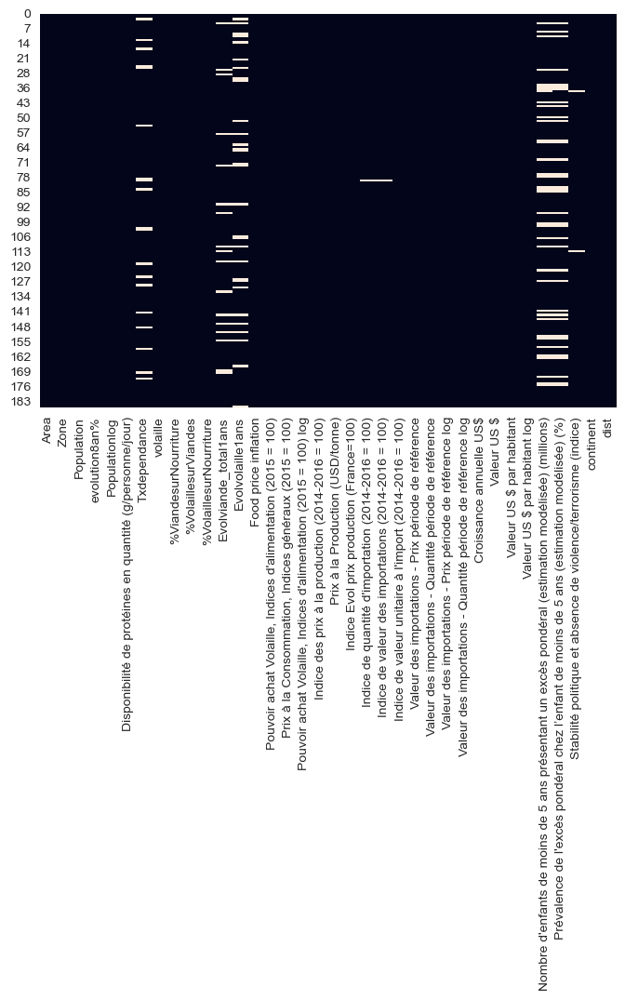

In [57]:
exploration(etuds)

In [58]:
etuds.describe()

,Population,evolution8an%,Populationlog,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,volaille,%ViandesurNourriture,%VolaillesurViandes,%VolaillesurNourriture,Evolviande_total1ans,Evolvolaille1ans,Food price inflation,"Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)","Prix à la Consommation, Indices généraux (2015 = 100)","Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",Indice des prix à la production (2014-2016 = 100),Prix à la Production (USD/tonne),Indice Evol prix production (France=100),Indice de quantité d'importation (2014-2016 = 100),Indice de valeur des importations (2014-2016 = 100),Indice de valeur unitaire à l'import (2014-2016 = 100),Valeur des importations - Prix période de référence,Valeur des importations - Quantité période de référence,Valeur des importations - Prix période de référence log,Valeur des importations - Quantité période de référence log,Croissance annuelle US$,Valeur US $,Valeur US $ par habitant,Valeur US $ par habitant log,Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions),Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%),Stabilité politique et absence de violence/terrorisme (indice),dist
count,1.850000e+02,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,1.850000e+02,1.850000e+02,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000,1.850000e+02,1.850000e+02,185.000000,185.000000,185.000000,1.850000e+02,185.000000,185.000000,185.000000,185.000000,185.000000,185.000000
mean,4.215278e+04,11.397530,8.935776,7.787189,40.984557,687.140541,0.094800,0.322238,0.033492,0.008971,0.145546,34.027261,8.522861e+07,6.898370e+07,4.972384,113.838973,2070.719459,111.267514,265.224324,184.583784,94.172973,1.413133e+05,1.165226e+05,9.900592,9.592070,-5.071421,4.549268e+05,13357.637340,8.621199,0.151189,5.530270,-0.112973,-6155.201039
std,1.513913e+05,10.685817,2.017247,5.993132,41.334110,2335.373742,0.052598,0.161918,0.028713,0.072603,1.624881,300.775328,1.159232e+09,9.382773e+08,1.452136,34.010981,691.714676,33.243032,821.394205,375.870113,45.882320,3.545887e+05,2.720683e+05,2.468070,2.545312,12.804489,1.955581e+06,18897.385175,1.388735,0.363567,4.655087,0.943626,3961.048701
min,1.231500e+01,-12.042000,2.510818,0.160000,0.000000,1.000000,0.010000,0.008000,0.001000,-0.232028,-0.435294,-2.349265,9.270404e+01,9.748084e+01,4.529412,56.860000,637.900000,55.580000,0.000000,0.000000,16.000000,2.000000e+00,7.000000e+00,0.693147,1.945910,-55.881606,1.354122e+02,285.875782,5.655557,0.000000,0.000000,-2.730000,-19263.880000
25%,2.546402e+03,3.579000,7.842437,2.390000,4.976097,33.000000,0.056000,0.193000,0.012000,-0.023178,-0.043502,1.900521,1.059654e+02,1.050286e+02,4.663113,98.710000,1954.450000,96.480000,97.000000,84.000000,75.000000,5.417000e+03,2.956000e+03,8.597297,7.991592,-10.600886,1.176239e+04,1895.770703,7.547381,0.001000,2.100000,-0.650000,-8763.332000
50%,9.749640e+03,10.080000,9.184986,6.970000,25.272547,105.000000,0.085000,0.322000,0.027000,0.000000,0.000000,3.578659,1.142091e+02,1.113039e+02,4.738023,107.450000,1954.450000,105.020000,117.500000,107.000000,90.000000,2.651400e+04,1.774600e+04,10.185329,9.783896,-3.925009,3.921812e+04,5180.914198,8.552737,0.001000,5.000000,-0.020000,-5620.005000
75%,3.218040e+04,18.125000,10.379113,11.580000,75.000000,333.000000,0.124000,0.441000,0.046000,0.032001,0.059490,7.622319,1.324789e+02,1.271422e+02,4.886423,116.070000,1954.450000,113.450000,171.000000,150.000000,101.000000,1.263570e+05,9.959400e+04,11.746867,11.508857,0.912962,2.285392e+05,15449.237002,9.645315,0.100000,8.100000,0.670000,-3215.215000
max,1.424930e+06,51.538000,14.169633,28.380000,265.887850,21555.000000,0.290000,0.677000,0.180000,0.424421,22.000000,4026.665430,1.576726e+10,1.276195e+10,23.481201,300.960000,6000.600000,294.160000,8943.000000,3818.000000,488.000000,3.270008e

<div style="text-align: justify"> La table final regroupent 36 variables permettant d'analyser 185 pays sur l'année 2020. <br>
On y retrouve aucune donnée Manquante ni doublon. </div

  0%|                                                  | 0/8207 [00:00<?, ?it/s]

/Users/lauren/opt/anaconda3/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/Users/lauren/opt/anaconda3/lib/python3.9/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: 'Indice de val...00)', 'Valeur des im...nce', 'Valeur des im...log'


DataPrep Report
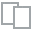
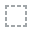
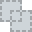
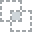
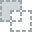
...
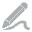
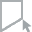
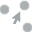
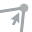
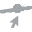

In [59]:
create_report(etuds)

* [sommaire](#sommaire)

<div style="background-color: #F56086;">
    <a class="anchor" id="III.d"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">d) Préparation</h2>
</div>

<a class="anchor" id="III.d.3"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">préparation des données pour le clustering</h2>




In [60]:
# Suppression des variables que je n'utiliserais pas pour la création des clusters
etud=etuds.drop(["Zone", "continent",
#               "Population",
#               
                 "Populationlog",                
#                
                 "evolution8an%",
                 

                 
#                "Disponibilité de protéines en quantité (g/personne/jour)",
#                "Txdependance",
#               
                 "volaille",                
#               
                 "%ViandesurNourriture",
#                "%VolaillesurViandes",
#                "%VolaillesurNourriture",
#                
                 "Evolviande_total1ans",
#                
                 "Evolvolaille1ans",
                 
                 
                                  
#                "Food price inflation",
#                
                 "Pouvoir achat Volaille, Indices d'alimentation (2015 = 100)",
#              
                 "Prix à la Consommation, Indices généraux (2015 = 100)",
#               
                 "Pouvoir achat Volaille, Indices d'alimentation (2015 = 100) log",
                 
                 
#                
                 "Indice des prix à la production (2014-2016 = 100)",
#              
                 "Prix à la Production (USD/tonne)",
#                
                 "Indice Evol prix production (France=100)",

                 
                                  
#               
                 "Indice de quantité d'importation (2014-2016 = 100)", 
#               
                 "Indice de valeur des importations (2014-2016 = 100)",
#             
                 "Indice de valeur unitaire à l'import (2014-2016 = 100)",
#               
                 "Valeur des importations - Prix période de référence",
#               
                 "Valeur des importations - Quantité période de référence",                
#               "Valeur des importations - Prix période de référence log",
#                
                 "Valeur des importations - Quantité période de référence log",  

                 
#               
                 "Croissance annuelle US$",
#                 
                 "Valeur US $",
#                "Valeur US $ par habitant",
#               
                 "Valeur US $ par habitant log",
                 
                 
                 
#               
                 "Nombre d'enfants de moins de 5 ans présentant un excès pondéral (estimation modélisée) (millions)",
#                
                 "Prévalence de l'excès pondéral chez l’enfant de moins de 5 ans (estimation modélisée) (%)",
#                "Stabilité politique et absence de violence/terrorisme (indice)",
#                "dist"
               ],axis=1)


In [61]:
nbIndiv=len(etud)
nbVariables=len(etud.columns)-1  # je ne compte pas la colonne Pays

data=etud.set_index("Area")
X= data.values           # Stockage des valeurs

names= data.index        # stockage du nom des Individus (pays)

features=data.columns    # Stockage du nom des variables 

In [62]:
for i in features:
    print("Nombre inf", np.isinf(data[i]).values.sum())

Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0
Nombre inf 0


In [63]:
for i in features:
    print("Nombre NaN",i, np.isnan(data[i]).values.sum())

Nombre NaN Population 0
Nombre NaN Disponibilité de protéines en quantité (g/personne/jour) 0
Nombre NaN Txdependance 0
Nombre NaN %VolaillesurViandes 0
Nombre NaN %VolaillesurNourriture 0
Nombre NaN Food price inflation 0
Nombre NaN Valeur des importations - Prix période de référence log 0
Nombre NaN Valeur US $ par habitant 0
Nombre NaN Stabilité politique et absence de violence/terrorisme (indice) 0
Nombre NaN dist 0


Il n'y a pas d'inf ni de NaN dans ma table.

* [sommaire](#sommaire)

<a class="anchor" id="III.d.4"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF">Centrer-Réduire </h2>




In [64]:
## CENTRAGE REDUCTION DES DONNEES CAR LES ECHELLES DE MESURES SONT HETEROGENES

#  MinMax
X_scaled = MinMaxScaler().fit_transform(X)

# Standardise
#X_scaled= StandardScaler().fit_transform(X)

# RobustScaler
#X_scaled = RobustScaler(quantile_range=(25, 75)).fit_transform(X)

# MaxAbs
#X_scaled = MaxAbsScaler().fit_transform(X)

# PowerTransformer
#X_scaled = PowerTransformer(method="yeo-johnson").fit_transform(X)
#X_scaled = PowerTransformer(method="box-cox").fit_transform(X)

# QuantileTransformer
#X_scaled = QuantileTransformer(output_distribution="uniform").fit_transform(X)
#X_scaled = QuantileTransformer(output_distribution="normal").fit_transform(X)

# Normalizer
#X_scaled = Normalizer().fit_transform(X)

idx = ["mean", "std", "min", "max"]
pd.DataFrame(X_scaled).describe().round(2).loc[idx, :]

,0,1,2,3,4,5,6,7,8,9
mean,0.03,0.27,0.15,0.47,0.18,0.01,0.64,0.11,0.62,0.69
std,0.11,0.21,0.16,0.24,0.16,0.07,0.17,0.16,0.22,0.21
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


<div style="text-align: justify"> J'ai testé différentes méthodes de centrage réduction du jeu de données car les unités sont différentes suivant les variables. J'ai choisi la méthode qui valorise le mieux mon jeu de donnée pour une analyse des clusters. </div

In [65]:
idx = ["min", "max"]
pd.DataFrame(data).describe().round(2).loc[idx, :]

,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
min,12.32,0.16,0.00,0.01,0.00,-2.35,0.69,285.88,-2.73,-19263.88
max,1424929.78,28.38,265.89,0.68,0.18,4026.67,15.00,117181.65,1.49,-262.38


In [66]:
nbIndiv=len(etud)
nbVariables=len(etud.columns)-1

data=etud.set_index("Area")
X= data.values           # Stockage des valeurs

names= data.index        # stockage du nom des Individus (pays)

features=data.columns    # Stockage du nom des variables 

,Area,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
0,"China, mainland",1424929.781,4.82,6.966423,0.170,0.015,8.402772,15.000303,10228.970558,0.00,-8225.2320
1,India,1396387.127,0.87,0.000000,0.164,0.005,8.766756,6.716595,1930.971218,-0.86,-6594.2300
2,Israel,8757.489,28.38,0.000000,0.517,0.079,-0.005526,10.185329,47033.586547,-0.83,-3281.8990
3,Luxembourg,630.399,7.06,108.333333,0.201,0.019,2.727798,10.730947,117181.646629,1.23,-289.1023
4,Nauru,12.315,17.79,100.000000,0.654,0.180,3.578659,7.228388,12510.366256,0.94,-14455.0900
5,Netherlands,17434.557,4.14,265.887850,0.149,0.011,1.895359,13.553091,53333.657572,0.85,-427.9169
6,New Zealand,5061.133,9.31,0.480769,0.256,0.036,3.281721,6.846943,43972.130573,1.49,-19263.8800
7,Saint Vincent and the Grenadines,104.632,26.04,100.000000,0.677,0.105,1.825816,9.282196,7298.372827,1.03,-6989.7010
8,United States of America,335942.003,20.94,0.695625,0.441,0.060,3.506064,12.480985,63122.594145,-0.02,-5838.1570
9,Venezuela,28490.453,5.74,0.218341,0.354,0.031,4026.665430,9.246865,3740.287361,-1.52,-7618.8600


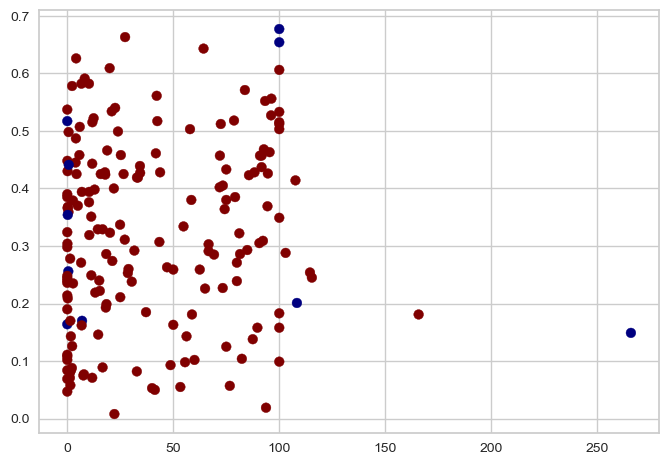

In [67]:
model= IsolationForest(n_estimators=100, contamination=0.05,random_state= 0)
model.fit(X)
plt.scatter(X[:,2], X[:,3], c=model.predict(X),  cmap = 'jet')
outliers= model.predict(X) ==-1
outlier=data[outliers].reset_index()
outlier

<div style="text-align: justify"> J'ai appliqué l'isolation Forest qui permet de détecter les individus outliers qui risquent de déséquilibrer les classes. Cette technique non supervisée permet de détecter directement les outliers sans discriminer les points à cause d'un profil global normalisé.  </div

In [68]:
## retirer outliers qui risquent d'influencer les clusters, les pays sans intérêt commercial et la France du dataset original.

# les Pays fermés au commerce international et la France
dictatures= ("Korea, Dem. People's Rep. of", "Democratic Republic of the Congo", "France" )

# Les Pays avec une forte instabilité politique
Stab= etud[etud["Stabilité politique et absence de violence/terrorisme (indice)"]<-2.5]

# Les petites Iles qui ont un faible potentiel commercial au vu du nombre d'habitants
Iles= etuds[etuds["Population"]<500]


# les outliers détectés par IsolationForest qui déséquilibre les classes
etud = etud [~etud["Area"].isin(outlier.Area)] 
etud = etud [~etud["Area"].isin(dictatures)]
etud = etud [~etud["Area"].isin(Iles.Area)]
etud = etud [~etud["Area"].isin(Stab.Area)]


In [69]:
# liste des Pays avec une Variable calculée par Médiane (PIB, Pouvoir Achat, InCOm, Secu)
VariableMedian=("Taiwan", "Cuba", "Turkménistan", "Nepal", "Nouvelle Calédonie")

In [70]:
etud.describe()

,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
count,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000
mean,28205.866093,7.007351,36.249975,0.311788,0.029119,13.398758,9.903518,12053.555657,-0.166358,-5744.064334
std,45686.997774,5.244671,36.270940,0.160647,0.022719,63.326745,2.553010,16893.197671,0.838517,3584.743271
min,514.438000,0.160000,0.000000,0.008000,0.001000,-2.349265,0.693147,285.875782,-2.480000,-16975.460000
25%,3931.390500,2.060000,4.271028,0.184000,0.011000,2.139123,8.578679,1777.285120,-0.655000,-8735.504500
50%,10368.969000,6.640000,22.222222,0.307000,0.024000,3.711028,10.266358,4949.744130,-0.150000,-5249.535000
75%,32690.197000,10.415000,65.833333,0.428000,0.039500,7.516038,11.836744,13582.975798,0.580000,-2177.268000
max,271857.970000,21.270000,165.745856,0.663000,0.113000,728.589588,14.365449,86918.648293,1.250000,-262.384500


In [71]:
etuds = etuds [~etuds["Area"].isin(outlier.Area)] 
etuds = etuds [~etuds["Area"].isin(dictatures)]
etuds = etuds [~etuds["Area"].isin(Iles.Area)]
etuds = etuds [~etuds["Area"].isin(Stab.Area)]

In [72]:
etud.to_csv('etudQTT.csv', index=False, sep=",")
etuds.to_csv('etudQLT.csv', index=False, sep=",")

In [73]:
nbIndiv=len(etud)
nbVariables=len(etud.columns)-1

data=etud.set_index("Area")
X= data.values           # Stockage des valeurs

names= data.index        # stockage du nom des Individus (pays)

features=data.columns    # Stockage du nom des variables 

In [74]:
## CENTRAGE REDUCTION DES DONNEES CAR LES ECHELLES DE MESURES SONT HETEROGENES

#  MinMax
X_scaled = MinMaxScaler().fit_transform(X)

idx = ["mean", "std", "min", "max"]
pd.DataFrame(X_scaled).describe().round(2).loc[idx, :]

,0,1,2,3,4,5,6,7,8,9
mean,0.10,0.32,0.22,0.46,0.25,0.02,0.67,0.14,0.62,0.67
std,0.17,0.25,0.22,0.25,0.20,0.09,0.19,0.19,0.22,0.21
min,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
max,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00


<div style="text-align: justify"> Après avoir supprimé les individus qui risqueraient d'influencer les différents clusters et sans intérêt pour notre étude de marché, j'ai de nouveau préparé la nouvelle table et je les ai centré réduit.  </div

* [sommaire](#sommaire)

# IV. Analyse <a class="anchor" id="IV"></a>

<div style="background-color: #F56086;">
    <a class="anchor" id="IV.a"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">a) Univarié </h2>
</div>

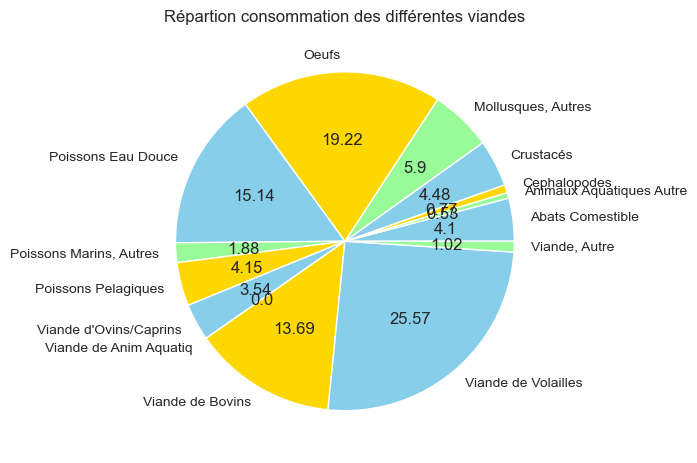

In [75]:
dispoprote=dispoprot[dispoprot["Élément"]=="Nourriture"]
dispoprotal=dispoprote.pivot_table(index= ["Zone","Code zone (FAO)"], columns=["Produit"], values="Valeur", margins=True).reset_index().fillna(0.0)

All=dispoprotal[dispoprotal["Zone"]=="All"]
All=All.drop(columns=["All", "Zone", "Code zone (FAO)"])
ALL=All.sum().sum()
viand= ('Abats Comestible', 'Animaux Aquatiques Autre', 'Cephalopodes',
       'Crustacés', 'Mollusques, Autres', 'Oeufs', 'Poissons Eau Douce',
       'Poissons Marins, Autres', 'Poissons Pelagiques',
       'Viande d\'Ovins/Caprins', 'Viande de Anim Aquatiq', 'Viande de Bovins',
       'Viande de Volailles', 'Viande, Autre',)

concat=[]

for i in viand:
    c=round((All[i].sum() / ALL)*100, 2)
    concat.append(c)
    
CoNC= pd.DataFrame(concat,columns= ['quantite%'], index= [w for w in viand])

size= CoNC["quantite%"]
p,tx, autotexts = plt.pie(size, labels=viand, colors= ['skyblue', 'palegreen', 'gold'],
                           wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white'}, autopct="")

for i, a in enumerate(autotexts): 
    a.set_text("{}".format(size[i]))
    
plt.title("Répartion consommation des différentes viandes")
plt.show()

De toutes les viandes, la consommation de volaille est la plus importante au monde. elle représente plus de 25% de la consommation de viandes.

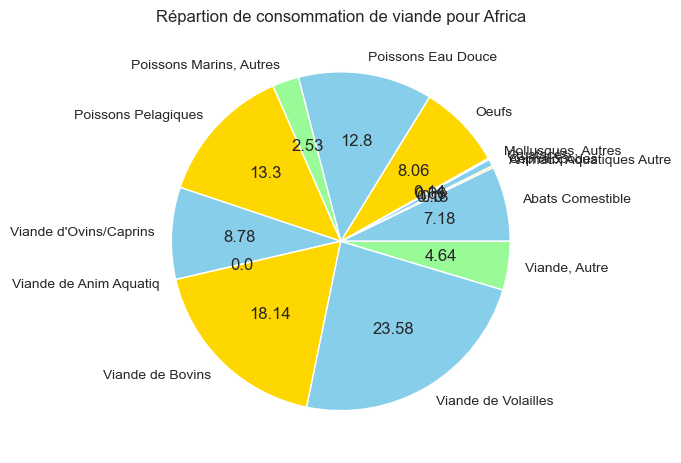

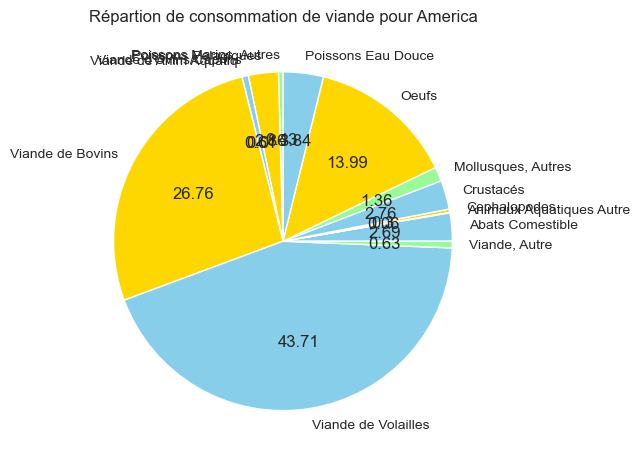

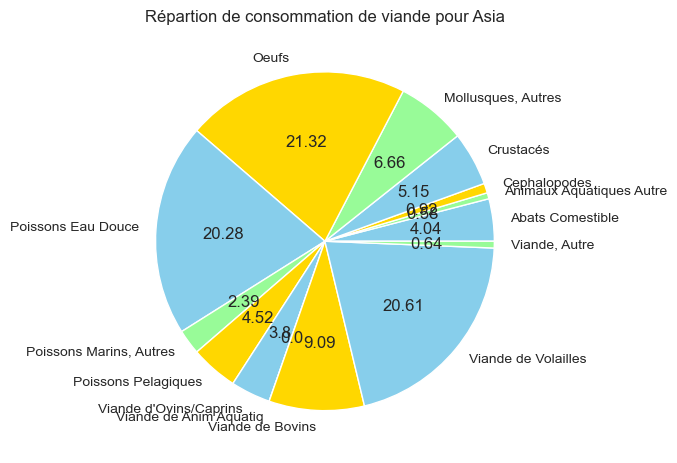

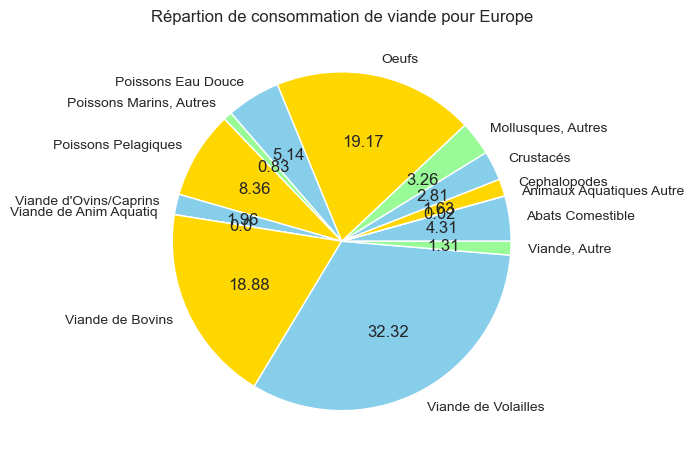

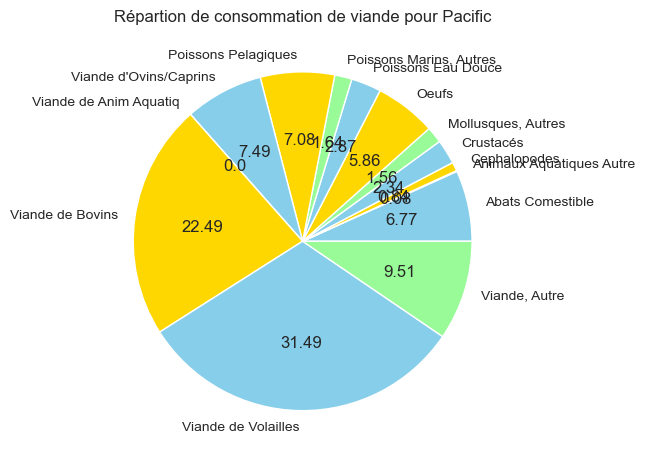

In [76]:
d=pd.merge(dispoprotal,Pays,  left_on="Code zone (FAO)", right_on='Area Code (FAO)', how='left',)
d= d.drop(["Area Code (FAO)", "Code zone (FAO)","Zone"  ],axis=1)
d=pd.merge(d,distance,  left_on="Area", right_on='country', how='left',)
d=d.dropna()
d= d.drop([ "All", "Area", "dist","country"  ],axis=1)
dd=d.groupby("continent").sum()
continent=dd.columns
ddi= dd.reset_index()
ddi= ddi.replace(0.0, 0.01)
ddd=ddi.set_index("continent")
liste=('Africa', 'America', 'Asia', 'Europe', 'Pacific')
liste2= ('Abats Comestible', 'Animaux Aquatiques Autre', 'Cephalopodes',
       'Crustacés', 'Mollusques, Autres', 'Oeufs', 'Poissons Eau Douce',
       'Poissons Marins, Autres', 'Poissons Pelagiques',
       'Viande d\'Ovins/Caprins', 'Viande de Anim Aquatiq', 'Viande de Bovins',
       'Viande de Volailles', 'Viande, Autre')


for w in liste:
    ddo=ddd[ddd.index==w]
    concat=[]

    for i in liste2:
        c=round((ddo[i].sum() / ddo.sum().sum())*100, 2)
        concat.append(c)
    
    CoNC= pd.DataFrame(concat,columns= ['quantite%'], index= [w for w in liste2])

    size= CoNC["quantite%"]
    p,tx, autotexts = plt.pie(size, labels=liste2, colors= ['skyblue', 'palegreen', 'gold'],
                           wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white'}, autopct="")

    for i, a in enumerate(autotexts): 
        a.set_text("{}".format(size[i]))
    plt.title(f"Répartion de consommation de viande pour {w}")
    plt.show()

De tous les continents, l'Amérique reste le continent qui consomment le plus de volaille à hauteur de 43%. L'Europe et le Pacifique suivent avec 31%. <br>
Les Continents qui consomment le moins sont l'Afrique et l'Asie. 

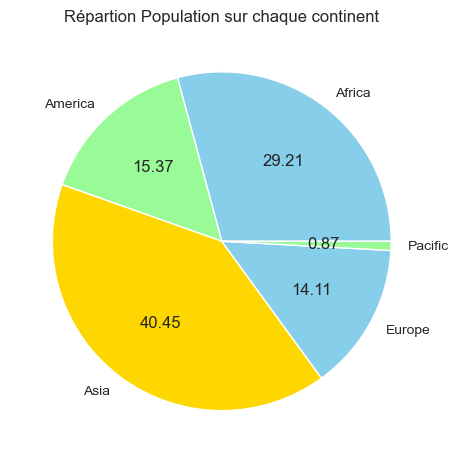

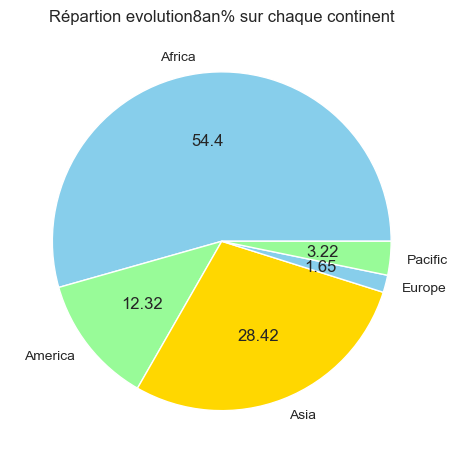

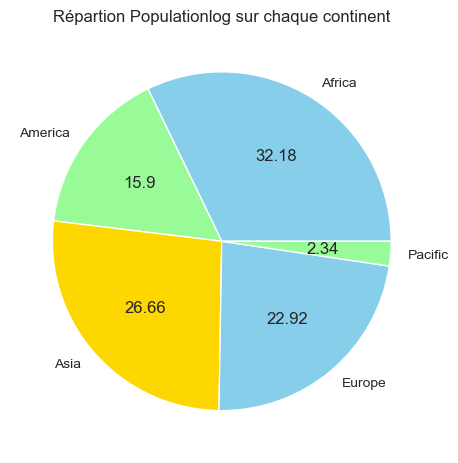

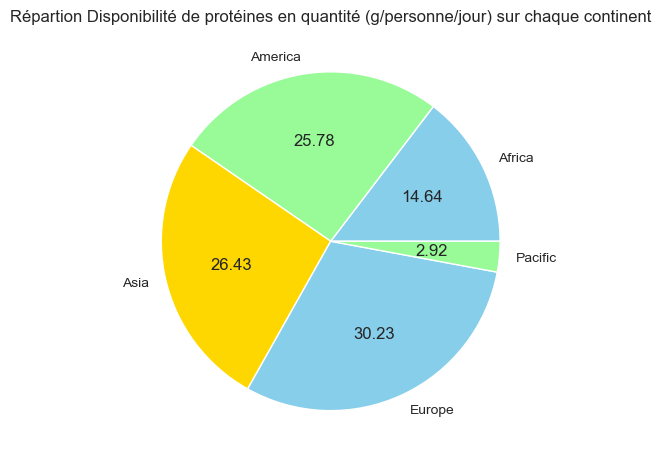

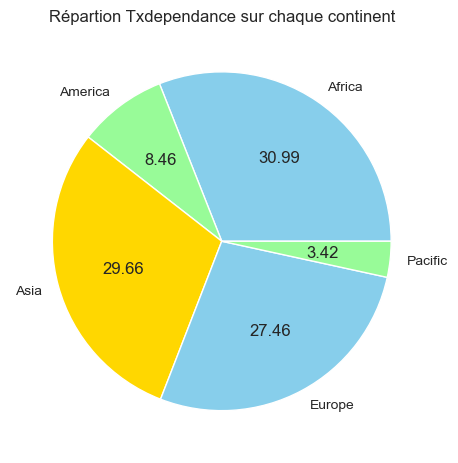

...

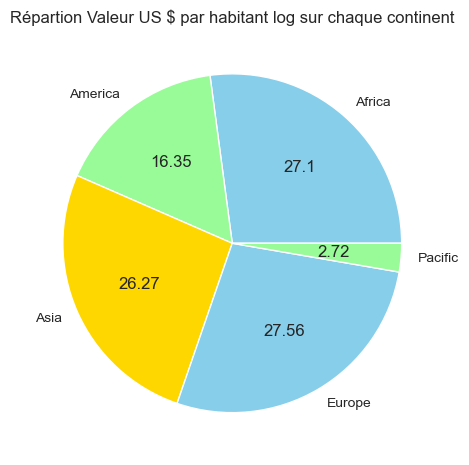

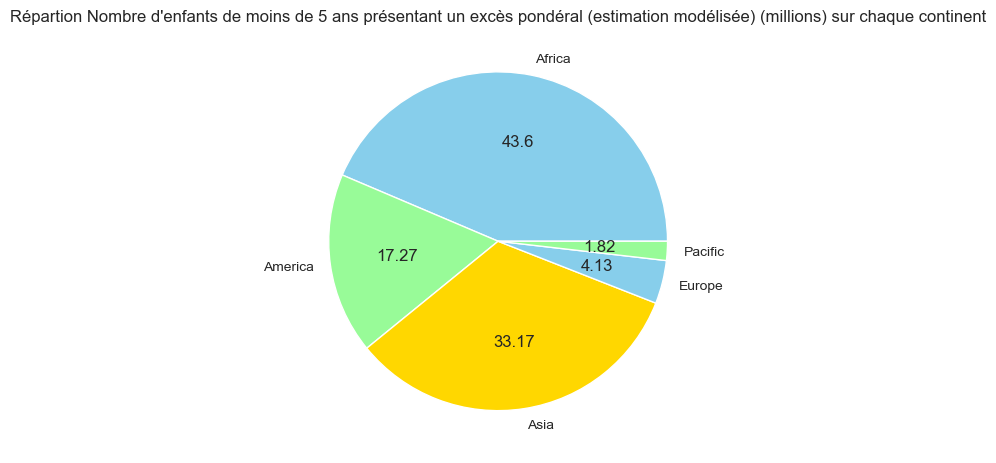

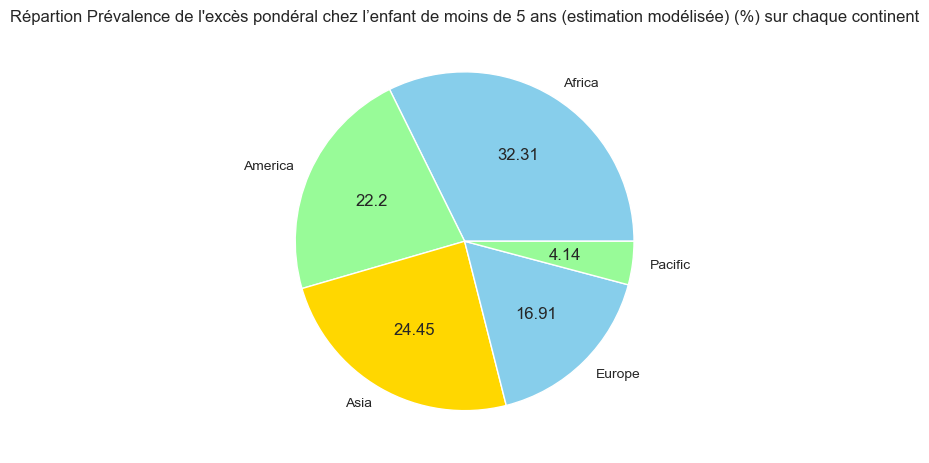

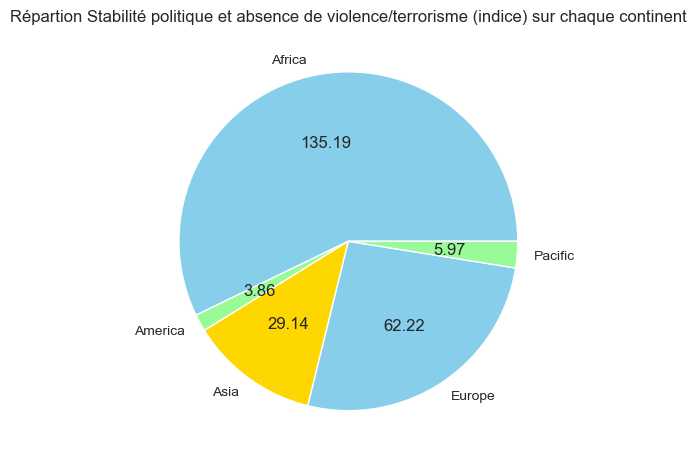

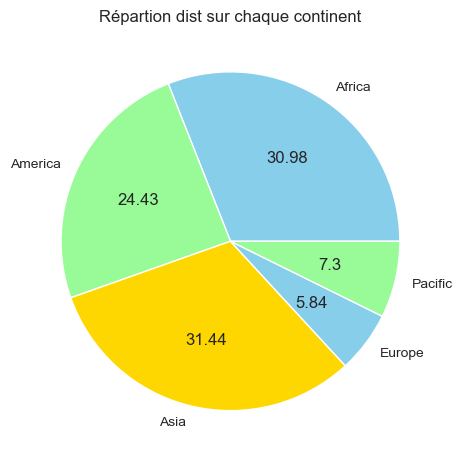

In [77]:
d= etuds.drop([ "Area","Zone" ],axis=1)
dd=d.groupby("continent").sum().reset_index()
liste=d.set_index("continent")

for w in liste:
    ddd=dd.pivot_table(columns="continent", values=w)
    total=ddd.sum().sum()
    continent=ddd.columns

    concat=[]

    for i in continent:
        c=abs(round((ddd[i].sum() / total)*100, 2))
        concat.append(c)
    
    CoNC= pd.DataFrame(concat,columns= ['quantite%'], index= [w for w in continent])

    size= CoNC["quantite%"]
    p,tx, autotexts = plt.pie(size, labels=continent, colors= ['skyblue', 'palegreen', 'gold'],
                           wedgeprops = { 'linewidth' : 1, 'edgecolor' : 'white'}, autopct="")

    for i, a in enumerate(autotexts): 
        a.set_text("{}".format(size[i]))
    plt.title(f"Répartion {w} sur chaque continent")
    plt.show()

Le Continent avec le plus de population est l'Asie suivi de l'Afrique <br>
Le Continent avec la plus évolution de la population est l'Afrique suivi de l'Asie<br>
Le Continent avec la plus disponibilité de protéine de volaille par habitant est l'Amérique suivi de l'Europe<br>
Le Continent avec le plus grand taux de dépendance d'importation de volaille est l'Afrique suivi de l'Europe <br>
Le Continent avec la plus grande consommation de volaille est l'Asie suivi de l'Amérique <br>
Le Continent avec le plus haut pourcentage de consommation de viandes par rapport à l'alimentation générale est l'Asie suivi de l'Amérique <br>
Le Continent avec le plus haut pourcentage de consommation de volaille par rapport  aux autres viandes est l'Amérique suivi de l'Asie <br>
Le Continent avec le plus haut pourcentage de consommation de volaille par rapport à l'alimentation générale est  l'Amérique suivi de l'Asie <br>
Le Continent avec la plus grande augmentation de consommation de viande est l'Afrique suivi de l'Asie <br>
Le Continent avec la plus grande augmentation de consommation de volaille est l'Afrique suivi de l'Asie <br>
Le Continent avec le plus grand pourcentage d'inflation de pouvoir d'achat de volaille est l'Amérique suivi de l'Afrique <br>
Le Continent avec la plus grand quantité d'importation de volaille est l'Asie suivi de l'Europe <br>
Le Continent avec le plus grand coût d'importation de volaille est l'Asie suivi de l'Europe <br>
Le Continent avec le plus haut PIB est l'Asie suivi de l'Amérique <br>
Le Continent avec le plus haut la meilleure croissance du PIB est l'Amérique suivi de l'Asie <br>
Le Continent avec le plus haut PIB par habitant est l'Europe suivi de l'Asie <br>

* [sommaire](#sommaire)

<div style="background-color: #F56086;">
    <a class="anchor" id="IV.b"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">b) Bivarié </h2>
</div>

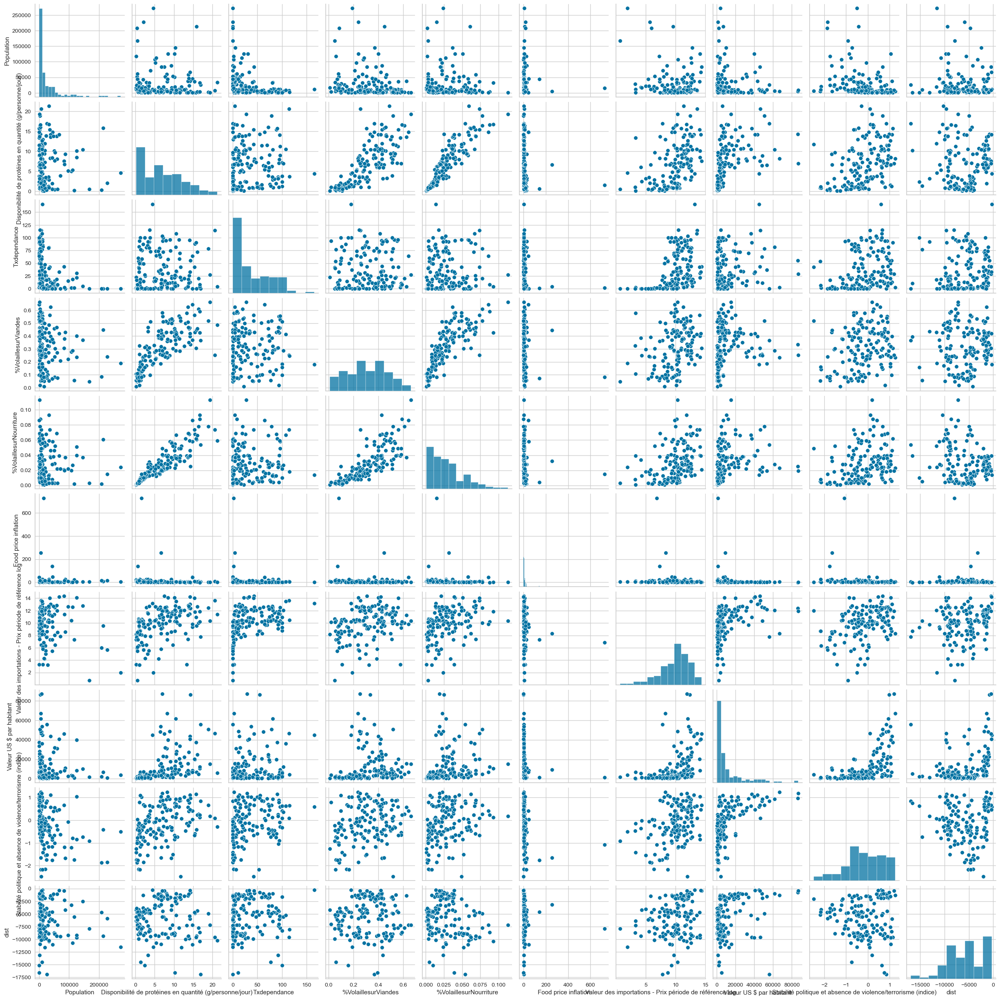

In [78]:
sns.pairplot(etud)

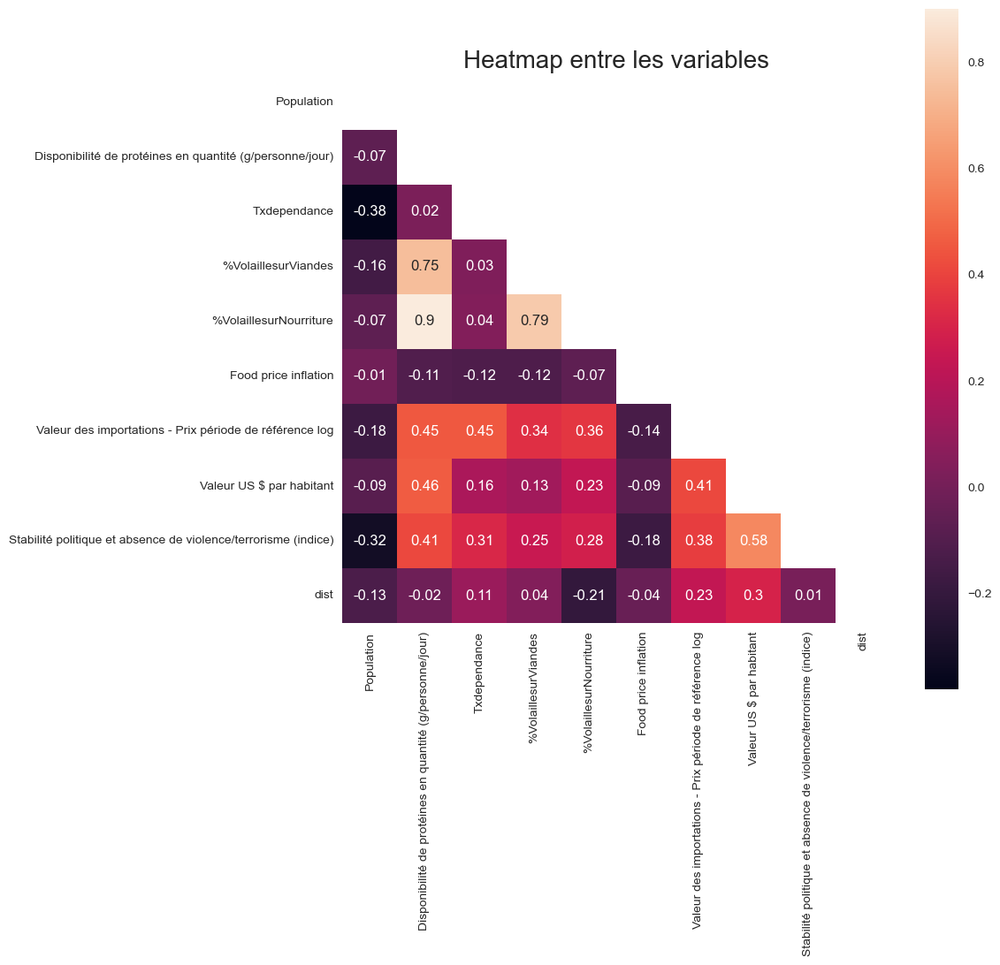

In [79]:
#Calcul du coef de pearson.
corr=round(etud.corr(),2)

# Création d'un masque pour faire disparaitre une partie de la matrice. 
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

# création de la Heatmap. 
with sns.axes_style("white"):
     f, ax = plt.subplots(figsize=(10, 10))
     ax = sns.heatmap(corr, mask=mask, vmax=0.9, square=True,annot=True)
     plt.title("Heatmap entre les variables", fontsize=20)

On remarque que les variables les plus corrélées concernent surtout la consommation de volaille. <br>
On remarque également une légère corrélation entre la valeur du PIB, stabilité politique et valeur d'importation.  <br>
On remarque enfin une légère corrélation négative entre la population et le taux de dépendance. 

* [sommaire](#sommaire)

<div style="background-color: #F56086;">
    <a class="anchor" id="IV.c"></a>
<h2 style="text-align: center; text-decoration:bold; margin: auto; padding: 5px; color:#36151D;">c) Exploratoire </h2>
</div>

<a class="anchor" id="IV.c.1"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF"> 1) Eboulis des Valeurs Propres </h2>




Table des Variances


,Dimension,Variance expliquée,% variance expliquée,% cum. var. expliquée
0,Dim1,0.169099,41.0,41.0
1,Dim2,0.080315,19.0,60.0
2,Dim3,0.047239,11.0,72.0
3,Dim4,0.042600,10.0,82.0
4,Dim5,0.026972,7.0,89.0
5,Dim6,0.015497,4.0,92.0
6,Dim7,0.014424,3.0,96.0
7,Dim8,0.007558,2.0,98.0
8,Dim9,0.006881,2.0,99.0
9,Dim10,0.002863,1.0,100.0


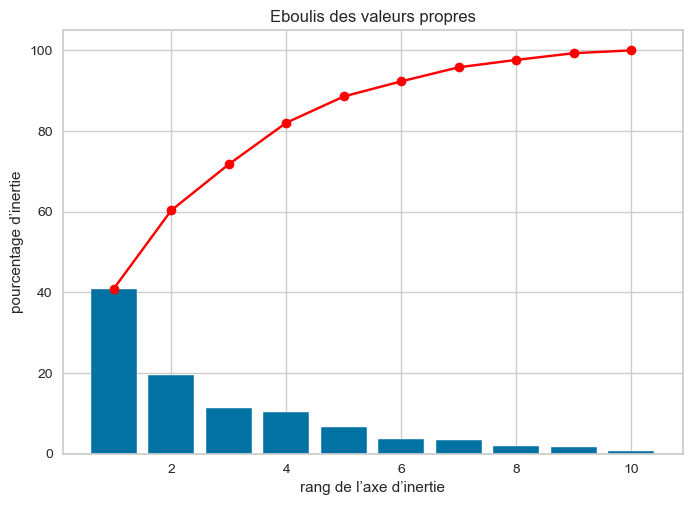

In [80]:
# VARIANCE EXPLIQUE

n_comp= data.shape[1]                      # Nombre composants
pca=decomposition.PCA(n_components=n_comp)  
pca.fit_transform(X_scaled)               
X_projected =pca.fit_transform(X_scaled)  # Je conserve la projection des variables dans une variables

Vari= pca.explained_variance_                         # Valeurs propres
eigval= (nbIndiv-1) / nbIndiv * Vari                  # Valeurs propres corrigée
scree= pca.explained_variance_ratio_*100

plt.bar(np.arange(len(scree))+1, scree)
plt.plot(np.arange(len(scree))+1, scree.cumsum(), c='red', marker='o')
plt.xlabel('rang de l’axe d’inertie')
plt.ylabel('pourcentage d’inertie')
plt.title("Eboulis des valeurs propres")

ValPro = pd.DataFrame(
    { "Dimension" : ["Dim" + str(x + 1) for x in range(nbVariables)], 
        "Variance expliquée" : eigval,
        "% variance expliquée" : np.round(scree),
        "% cum. var. expliquée" : np.round(np.cumsum(scree))})
print(P.B+"Table des Variances"+P.E)
ValPro

En sélectionnant le premier plan factoriel, nous conservons 60% de l'inertie totale. 

Au vu de l'éboulis des valeurs propres, certaines Variables sont corrélées et en sélectionnant les 4 premières dimensions nous conserverions près de 82 % de l'inertie totale de l'information. 

Nous pourrions donc réduire le nombre de variables aux quatre premières dimensions en perdant seulement 18% de l'information. 

* [sommaire](#sommaire)

<a class="anchor" id="IV.c.2"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF"> 2) Lien entre Variables </h2>




Qualité de réprésentation


,ID,COS2_1,COS2_2
1,Disponibilité de protéines en quantité (g/pers...,0.052916,0.003435
3,%VolaillesurViandes,0.040051,0.006874
4,%VolaillesurNourriture,0.030594,0.006411
8,Stabilité politique et absence de violence/ter...,0.017587,0.011534
6,Valeur des importations - Prix période de réfé...,0.012735,0.006011
7,Valeur US $ par habitant,0.010627,0.008018
2,Txdependance,0.002668,0.022132
0,Population,0.001587,0.004969
5,Food price inflation,0.000193,0.000074
9,dist,0.000143,0.010856


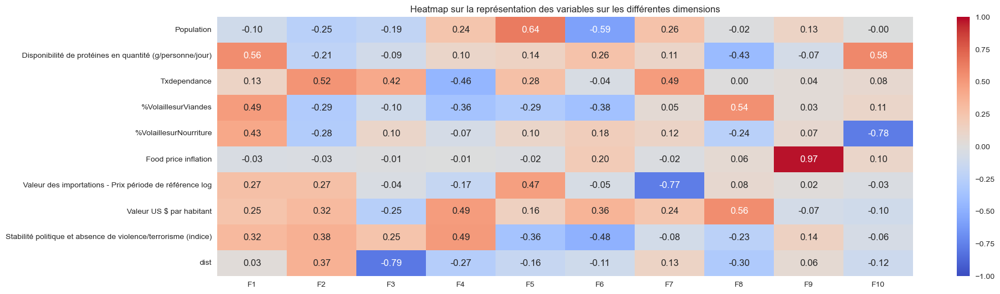

In [81]:
# REPRESENTATION VARIABLES

pcs= pca.components_         # Vecteurs Propres

pcsvariable = pd.DataFrame(pcs)

x_list = range(1, n_comp+1)
list(x_list)

pcsvariable.columns = features
pcsvariable.index= [f"F{i}" for i in x_list]

fig, ax = plt.subplots(figsize=(20, 6))
sns.heatmap(pcsvariable.transpose(), vmin=-1, vmax=1, annot=True, cmap="coolwarm", fmt="0.2f")
plt.title("Heatmap sur la représentation des variables sur les différentes dimensions")

##### 

# Corrélations 
sqrt_eigval = np.sqrt(eigval)
corvar = np.zeros((nbVariables,nbVariables))

for i in range(nbVariables):   # Mettre les variables en Lignes et les facteurs en colonnes
    corvar[:,i] = pcs[i,:] * sqrt_eigval[i]

coordvar = pd.DataFrame({'id': data.columns, 'COR_1': corvar[:,0], 'COR_2': corvar[:,1]})

# Qualité de représentation des Variables 
cos2var = corvar**2
Q=pd.DataFrame({'ID': data.columns, 'COS2_1':cos2var[:,0], 'COS2_2':cos2var[:,1]}).sort_values(by=["COS2_1"], ascending= [False])
print("Qualité de réprésentation")
Q



Cette représentation permet de mettre en avant pour chaque dimension, quelles variables sont les mieux représentés. 

* [sommaire](#sommaire)

# Représentation des Variables sur l'axe 1 et 2

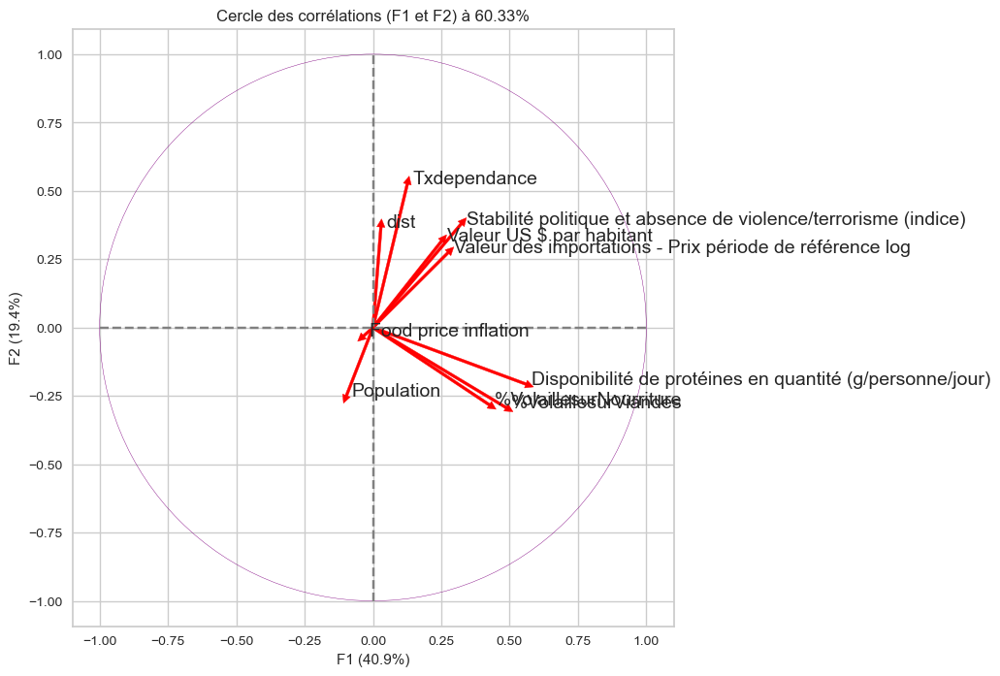

,id,CTR_1,CTR_2
1,Disponibilité de protéines en quantité (g/pers...,0.312928,0.042764
3,%VolaillesurViandes,0.236847,0.085586
4,%VolaillesurNourriture,0.180924,0.079827
8,Stabilité politique et absence de violence/ter...,0.104007,0.143613
6,Valeur des importations - Prix période de réfé...,0.075308,0.074842
7,Valeur US $ par habitant,0.062842,0.099838
2,Txdependance,0.015775,0.275570
0,Population,0.009382,0.061870
5,Food price inflation,0.001141,0.000926
9,dist,0.000844,0.135164


In [82]:
### Repésentation des Variables sur l'axe 1 et 2

correlation_graph(pca, [0,1], features)

# Contribution des Variables sur chaque Axe
ctrvar = cos2var
for i in range(nbVariables):
    ctrvar[:,i]= ctrvar[:,i]/eigval[i]
    
C=pd.DataFrame({'id': data.columns, 'CTR_1':ctrvar[:,0], 'CTR_2':ctrvar[:,1]})
C.sort_values(by=["CTR_1"], ascending=[False])

La Variable synthétique du premier axe représente les pays selon leur consommation de volaille. <br>
•  -1 les Pays consomment très peu de de volaille.<br>
•   1 les Pays Consomment beaucoup de volaille.

La Variable synthétique du deuxième axe représente les pays selon leur taux de dépendance à la volaille. <br>
•  -1 les Pays produisent plus de volaille que ce qu'ils importent. Ils s'auto suffisent.<br>
•   1 les Pays importent énormément la volaille afin de couvrir leurs besoins.


On la corrélation entre les 3 variables de consommations.  <br>
On retrouve également une certaine corrélation entre les variables stabilités, PIB et valeurs d'importations. Cependant, ces variables ne sont pas assez bien représentées pour réellement considérer une corrélation. 

In [83]:
np.sum(C, axis=0)

id       PopulationDisponibilité de protéines en quanti...
CTR_1                                                  1.0
CTR_2                                                  1.0
dtype: object

In [84]:
# Qualité de représentation des Variables sur axe 1 et 2
np.sum(Q.set_index("ID"), axis=1)


ID
Disponibilité de protéines en quantité (g/personne/jour)          0.056350
%VolaillesurViandes                                               0.046924
%VolaillesurNourriture                                            0.037005
Stabilité politique et absence de violence/terrorisme (indice)    0.029122
Valeur des importations - Prix période de référence log           0.018746
Valeur US $ par habitant                                          0.018645
Txdependance                                                      0.024800
Population                                                        0.006556
Food price inflation                                              0.000267
dist                                                              0.010998
dtype: float64

Ce sont donc les variables de consommations de volailles qui sont les mieux représentées. 

* [sommaire](#sommaire)

# Représentation des Variables sur l'axe 3 et 4

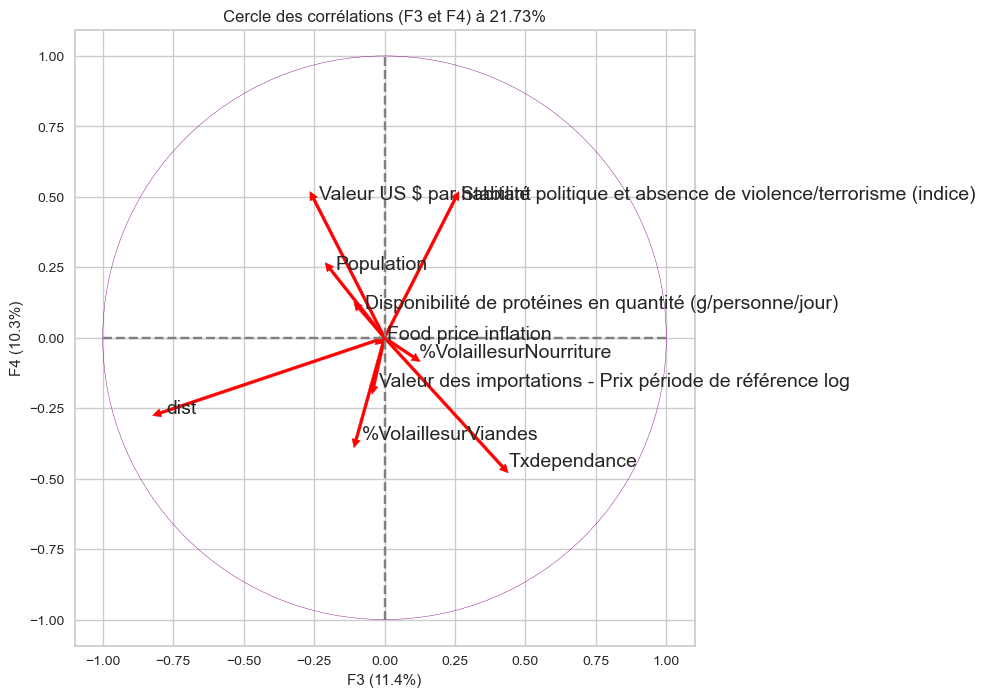

,id,CTR_3,CTR_4
9,dist,0.631869,0.071089
2,Txdependance,0.175336,0.209445
7,Valeur US $ par habitant,0.063052,0.242217
8,Stabilité politique et absence de violence/ter...,0.062696,0.242522
0,Population,0.036958,0.059189
4,%VolaillesurNourriture,0.010372,0.004616
3,%VolaillesurViandes,0.010124,0.130579
1,Disponibilité de protéines en quantité (g/pers...,0.008035,0.010832
6,Valeur des importations - Prix période de réfé...,0.001457,0.029461
5,Food price inflation,0.000101,0.000051


In [85]:
### Représentation des Variables sur l'axe 3 et 4

correlation_graph(pca, [2,3], features)

# Contribution des Variables sur chaque Axe
C2=pd.DataFrame({'id': data.columns, 'CTR_3':ctrvar[:,2], 'CTR_4':ctrvar[:,3]})
C2.sort_values(by=["CTR_3"], ascending=[False])

La Variable synthétique du troisième axe représente les pays selon leur distance par rapport à la France. <br>
•  -1 les Pays sont très proche de la France.<br>
•   1 les Pays sont très loin de la France.

La Variable synthétique du quatrième axe représente les pays selon PIB et leur stabilité politique. <br>
•  -1 les Pays ont un faible PIB avec une forte instabilité politique.<br>
•   1 les Pays ont un fort PIB et une forte stabilité politique.

On retrouve une corrélation négative entre stabilité et distance. <br>
Plus le PIB est élevé moins le taux de dépendendance est élevé. <br>

In [86]:
np.sum(C2, axis=0)

id       PopulationDisponibilité de protéines en quanti...
CTR_3                                                  1.0
CTR_4                                                  1.0
dtype: object

In [87]:
# Qualité de représentation des Variables sur axe 3 et 4
Q2=pd.DataFrame({'ID': data.columns, 'COS2_3':cos2var[:,2], 'COS2_4':cos2var[:,3]}).sort_values(by=["COS2_3"], ascending= [False])

np.sum(Q2.set_index("ID"), axis=1)

ID
dist                                                              0.702958
Txdependance                                                      0.384781
Valeur US $ par habitant                                          0.305269
Stabilité politique et absence de violence/terrorisme (indice)    0.305218
Population                                                        0.096146
%VolaillesurNourriture                                            0.014988
%VolaillesurViandes                                               0.140703
Disponibilité de protéines en quantité (g/personne/jour)          0.018867
Valeur des importations - Prix période de référence log           0.030918
Food price inflation                                              0.000151
dtype: float64

C'est donc la variable de distance  qui est la mieux représentée.

* [sommaire](#sommaire)

<a class="anchor" id="IV.c.3"></a>
<h2 style="text-align: center;text-decoration:bold;color:#736767;background-color:#F2DAEF"> 3) Lien entre Individus </h2>




In [88]:
 # Contribution des individus dans l'inertie totale
Contributionindv = np.sum(X_scaled**2, axis=1)   # carrés des distances à l'origine des individus
pd.DataFrame({'ID':data.index, 'd_i':Contributionindv }).sort_values(by=['d_i'], ascending=[False])
# Le Qatar et l'Irlande  se démarquent le plus des autres.


,ID,d_i
112,Qatar,4.402165
66,Ireland,4.366331
137,Trinidad and Tobago,4.223925
132,Switzerland,3.920563
11,Belgium,3.907835
...,...,...
9,Bangladesh,0.851709
86,Mali,0.818844
82,Madagascar,0.817782
141,Uganda,0.784626


* [sommaire](#sommaire)

# Repésentation des Individus sur l'axe 1 et 2

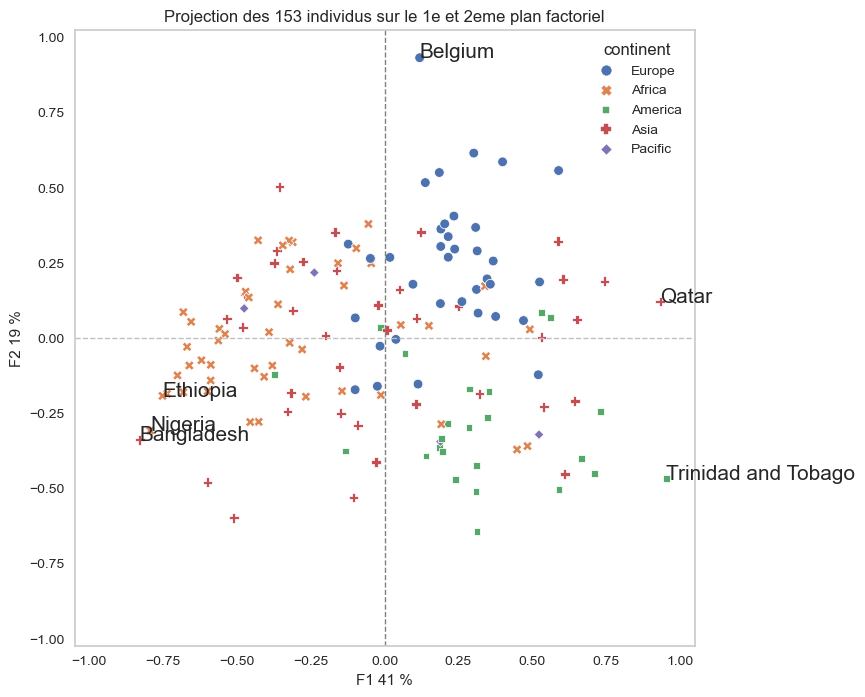

,ID,cos2_1,cos2_2
20,Burundi,0.990639,0.063745
9,Bangladesh,0.804593,0.135430
48,Ethiopia,0.607712,0.040242
86,Mali,0.565884,0.040167
141,Uganda,0.555757,0.010863
...,...,...,...
35,Croatia,0.000132,0.028637
15,Bosnia and Herzegovina,0.000112,0.000373
61,Haiti,0.000103,0.000541
93,Morocco,0.000079,0.018646


In [89]:
#REPRESENTATION DES INDIVIDUS sur l'axe 1 et 2

    
# Transformation en DataFrame pandas
PCA_indiv = pd.DataFrame({"Dim1" : X_projected[:,0], "Dim2" : X_projected[:,1],
                          "Dim3" : X_projected[:,2], "Dim4" : X_projected[:,3],
    "Country" : etud["Area"]})

Etuds=pd.merge(PCA_indiv, etuds, left_on="Country", right_on='Area', how='left')

display_factorial_planes(Etuds,"Dim1", "Dim2", 0,1, 0.75, 0.70,Etuds.continent,centroid= None, figsize=(8,8))


# Nous pouvons déduire la qualité de représentation des indiv sur l'axe 1-2
cos2= X_projected**2
for i in range(nbVariables):
    cos2[:,i]= cos2[:,i]/Contributionindv

pd.DataFrame({'ID':data.index, "cos2_1":cos2[:,0], "cos2_2":cos2[:,1] }).sort_values(by=["cos2_1"], ascending= [False])


La Variable synthétique du premier axe représente les pays selon leur consommation de volaille. <br>
Les Pays les mieux représentés sont la Trinité et Tobago et le Qatar.

La Variable synthétique du deuxième axe représente les pays selon leur taux de dépendance à la volaille. <br>
Les Pays les mieux représentés sont la Belgique et le Brésil.

In [90]:
# Contribution des individus dans chaque axe
ctr= X_projected**2
for i in range(nbVariables):
    ctr[:,i]= ctr[:,i]/(nbIndiv*eigval[i])

pd.DataFrame({'id':data.index, 'CTR_1':ctr[:,0], 
              'CTR_2':ctr[:,1]}).sort_values(by=["CTR_1"], ascending=[False])
# Trinidad and Tobago et Qatar sont déterminants pour le premier axe. 

,id,CTR_1,CTR_2
137,Trinidad and Tobago,0.035604,0.018169
112,Qatar,0.034108,0.001196
9,Bangladesh,0.026838,0.009511
100,Nigeria,0.024588,0.007875
48,Ethiopia,0.022105,0.003082
...,...,...,...
35,Croatia,0.000013,0.005889
15,Bosnia and Herzegovina,0.000009,0.000065
61,Haiti,0.000008,0.000089
93,Morocco,0.000006,0.003001


In [91]:
print(etud.set_index("Area").mean())
etud[etud.Area=="Trinidad and Tobago"]

Population                                                        28205.866093
Disponibilité de protéines en quantité (g/personne/jour)              7.007351
Txdependance                                                         36.249975
%VolaillesurViandes                                                   0.311788
%VolaillesurNourriture                                                0.029119
Food price inflation                                                 13.398758
Valeur des importations - Prix période de référence log               9.903518
Valeur US $ par habitant                                          12053.555657
Stabilité politique et absence de violence/terrorisme (indice)       -0.166358
dist                                                              -5744.064334
dtype: float64


,Area,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
168,Trinidad and Tobago,1518.147,19.29,27.272727,0.663,0.113,2.807369,10.328951,15285.973254,0.18,-7225.325


On y retrouve la trinité et le Qatar comme pays contribuant fortement à la représentation de l'axe 1. <br>
En regardant de plus près, la consommation de volaille est effectivement bien plus élevée que la moyenne mondiale à la Trinité et Tobago.

In [92]:
# Contribution des individus dans chaque axe
pd.DataFrame({'id':data.index, 'CTR_1':ctr[:,0], 
              'CTR_2':ctr[:,1]}).sort_values(by=["CTR_2"], ascending=[False])
# Netherlands et Switzerland sont déterminant pour le 2e axe

,id,CTR_1,CTR_2
11,Belgium,0.000553,7.150041e-02
17,Brazil,0.003835,3.419778e-02
132,Switzerland,0.003573,3.108908e-02
64,Indonesia,0.010194,2.952433e-02
40,Denmark,0.006247,2.821260e-02
...,...,...,...
117,Rwanda,0.011399,1.205655e-05
145,"Tanzania, United Rep. of",0.012374,7.283820e-06
7,Azerbaijan,0.001569,4.564943e-06
114,"Moldova, Rep.of",0.000058,2.452064e-06


In [93]:
print(etud.set_index("Area").mean())
etud[etud.Area=="Belgium"]

Population                                                        28205.866093
Disponibilité de protéines en quantité (g/personne/jour)              7.007351
Txdependance                                                         36.249975
%VolaillesurViandes                                                   0.311788
%VolaillesurNourriture                                                0.029119
Food price inflation                                                 13.398758
Valeur des importations - Prix période de référence log               9.903518
Valeur US $ par habitant                                          12053.555657
Stabilité politique et absence de violence/terrorisme (indice)       -0.166358
dist                                                              -5744.064334
dtype: float64


,Area,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
15,Belgium,11561.717,4.45,165.745856,0.181,0.014,2.88057,13.204914,45028.323405,0.59,-262.3845


On y retrouve la Belgique et le Brasil comme pays contribuant fortement à la représentation de l'axe 2. <br>
En regardant de plus près, le taux de dépendance est effectivement bien plus élevée que la moyenne mondiale à au Belgique.

* [sommaire](#sommaire)

# Repésentation des Individus sur l'axe 3 et 4

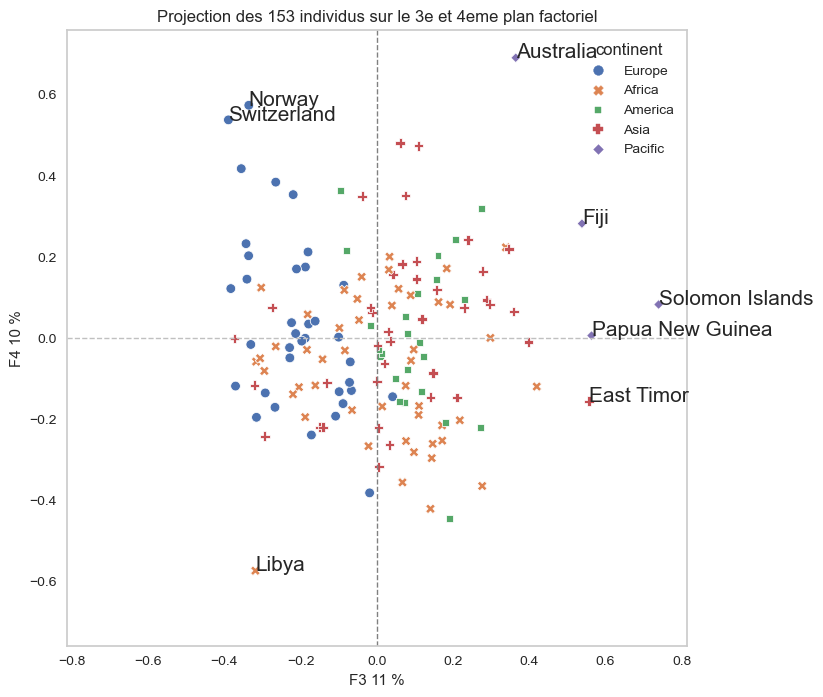

,ID,cos2_3,cos2_4
124,Solomon Islands,3.544002e-01,0.004341
106,Papua New Guinea,3.291778e-01,0.000029
135,East Timor,1.725671e-01,0.013612
49,Fiji,1.622891e-01,0.044287
85,Maldives,8.808005e-02,0.000059
...,...,...,...
90,Mexico,1.410824e-05,0.000327
53,Georgia,1.230578e-05,0.044918
4,Armenia,9.942400e-06,0.026943
95,Burma,2.761145e-06,0.000319


In [94]:
#REPRESENTATION DES INDIVIDUS sur l'axe 3 et 4


display_factorial_planes(Etuds,"Dim3", "Dim4", 2,3, 0.5, 0.5,Etuds.continent, figsize=(8,8))

# Nous pouvons déduire la qualité de représentation des indiv sur l'axe 1
cos2= X_projected**2
for i in range(nbVariables):
    cos2[:,i]= cos2[:,i]/Contributionindv

pd.DataFrame({'ID':data.index, "cos2_3":cos2[:,2], "cos2_4":cos2[:,3] }).sort_values(by=["cos2_3"], ascending= [False])

La Variable synthétique du troisième axe représente les pays selon leur distance par rapport à la France. <br>
Les Pays les mieux représentés sont les îles Salomon et la Papouasie nouvelle guinée.

La Variable synthétique du quatrième axe représente les pays selon PIB et leur stabilité politique. <br>
Les Pays les mieux représentés sont Australie et la Libye.


In [95]:
# Contribution des individus dans chaque axe

pd.DataFrame({'id':data.index, 'CTR_3':ctr[:,2], 
              'CTR_4':ctr[:,3]}).sort_values(by=["CTR_3"], ascending=[False])

,id,CTR_3,CTR_4
124,Solomon Islands,7.665863e-02,0.001041
106,Papua New Guinea,4.450564e-02,0.000004
135,East Timor,4.350968e-02,0.003806
49,Fiji,4.063316e-02,0.012296
96,Namibia,2.468917e-02,0.002250
...,...,...,...
90,Mexico,4.718449e-06,0.000121
53,Georgia,3.886672e-06,0.015732
4,Armenia,2.544550e-06,0.007646
95,Burma,4.390162e-07,0.000056


In [96]:
print(etud.set_index("Area").mean())
etud[etud.Area=="Solomon Islands"]

Population                                                        28205.866093
Disponibilité de protéines en quantité (g/personne/jour)              7.007351
Txdependance                                                         36.249975
%VolaillesurViandes                                                   0.311788
%VolaillesurNourriture                                                0.029119
Food price inflation                                                 13.398758
Valeur des importations - Prix période de référence log               9.903518
Valeur US $ par habitant                                          12053.555657
Stabilité politique et absence de violence/terrorisme (indice)       -0.166358
dist                                                              -5744.064334
dtype: float64


,Area,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
154,Solomon Islands,691.191,2.39,100.0,0.158,0.01,1.361126,9.308646,2250.563757,0.64,-15178.2


On y retrouve les îles Salomon et la Papouasie comme pays contribuant fortement à la représentation de l'axe 3. <br>
En regardant de plus près, la distance est effectivement bien plus élevée que la moyenne mondiale aux îles Salomon.

In [97]:
pd.DataFrame({'id':data.index, 'CTR_3':ctr[:,2], 
              'CTR_4':ctr[:,3]}).sort_values(by=["CTR_4"], ascending=[False])

,id,CTR_3,CTR_4
5,Australia,0.018639,7.398983e-02
80,Libya,0.014223,5.122115e-02
102,Norway,0.015810,5.099345e-02
132,Switzerland,0.021253,4.478351e-02
64,Indonesia,0.000530,3.575550e-02
...,...,...,...
106,Papua New Guinea,0.044506,4.392846e-06
116,Russian Federation,0.019512,4.262241e-07
81,Lithuania,0.001407,3.144603e-07
38,Czech Republic,0.004946,2.686267e-07


In [98]:
print(etud.set_index("Area").mean())
etud[etud.Area=="Australia"]

Population                                                        28205.866093
Disponibilité de protéines en quantité (g/personne/jour)              7.007351
Txdependance                                                         36.249975
%VolaillesurViandes                                                   0.311788
%VolaillesurNourriture                                                0.029119
Food price inflation                                                 13.398758
Valeur des importations - Prix période de référence log               9.903518
Valeur US $ par habitant                                          12053.555657
Stabilité politique et absence de violence/terrorisme (indice)       -0.166358
dist                                                              -5744.064334
dtype: float64


,Area,Population,Disponibilité de protéines en quantité (g/personne/jour),Txdependance,%VolaillesurViandes,%VolaillesurNourriture,Food price inflation,Valeur des importations - Prix période de référence log,Valeur US $ par habitant,Stabilité politique et absence de violence/terrorisme (indice),dist
7,Australia,25670.051,16.88,0.161031,0.366,0.054,3.281084,7.774436,55822.712845,0.85,-16975.46


On y retrouve l'Australie comme pays contribuant fortement à la représentation de l'axe 4. <br>
En regardant de plus près, le PIB et la stabilité sont effectivement bien plus élevés que la moyenne mondiale en Australie.

* [sommaire](#sommaire)

# Réduction des dimensions

In [99]:
n_comp = 4
pca=decomposition.PCA(n_components=n_comp) 
pca.fit_transform(X_scaled)               
X_projected =pca.fit_transform(X_scaled) 

In [100]:
PCA_indiv.to_csv('PCA_indiv.csv', index=False, sep=",")

J'ai réduit les variables à 4 dimensions. 

* [sommaire](#sommaire)